<a href="https://colab.research.google.com/github/ekity1002/DL4US_FINAL_WORK/blob/master/train_model2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


# データ読み込み

In [2]:
import sys
import csv
import copy
from tqdm import tqdm
import gc
import pickle

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

from tqdm import tqdm
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler, ReduceLROnPlateau, ModelCheckpoint
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Flatten, Lambda
from tensorflow.keras.applications.vgg16 import VGG16
#from tensorflow.keras.applications.xception import Xception
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Dense, Embedding, LSTM
from tensorflow.keras.layers import Reshape, Activation, concatenate, dot, BatchNormalization, GlobalAveragePooling2D
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from functools import partial
np.load = partial(np.load, allow_pickle=True)  # monkey patch

SEED=9999


In [0]:
def load_data():
    def load_pickle(path):
        with open(path, 'rb') as handle:
          return pickle.load(handle)

    # 学習データ
    x_train = np.load('/content/drive/My Drive/Colab Notebooks/data/train_img.npz')['arr_0']
    y_train = np.load('/content/drive/My Drive/Colab Notebooks/data/y_train.npy')
    tokenizer = load_pickle('/content/drive/My Drive/Colab Notebooks/data/tokenizer.pickle')
    # テストデータ
    x_test = np.load('/content/drive/My Drive/Colab Notebooks/data/test_img.npz')['arr_0']
    y_test = np.load('/content/drive/My Drive/Colab Notebooks/data/y_test.npy')
    #test_tokenizer = load_pickle('/content/drive/My Drive/Colab Notebooks/data/test_tokenizer.pickle')

    # 長さを最長のリストにそろえる。短いものは0パディング
    y_train = pad_sequences(y_train, padding='post')
    y_test = pad_sequences(y_test, padding='post')

    #return (x_train, y_train, train_tokenizer, x_test, y_test, test_tokenizer)
    return (x_train, y_train, x_test, y_test, tokenizer)

x_train, y_train, x_test, y_test, tokenizer = load_data()

In [0]:
print(x_train.shape)
print(y_train.shape)
tokenizer.index_word

# モデル学習

## モデルの定義

In [4]:
# 色々定義
detokenizer = dict(map(reversed, tokenizer.word_index.items()))
vocab_size = len(tokenizer.word_index)
print("vocab_size: ",vocab_size)
bos_eos = tokenizer.texts_to_sequences(["<s>", "</s>"])

vocab_size:  266


In [5]:
y_train_ohe = np.zeros((len(y_train), vocab_size))
for i, word_indexes in tqdm(enumerate(y_train)):
    for index in word_indexes:
        #print(index)
        if index != 0:
            y_train_ohe[i, index-1] = 1
print(y_train_ohe.shape)

4000it [00:00, 15670.65it/s]

(4000, 266)


In [0]:
x_tra, x_val, y_tra, y_val = train_test_split(x_train, y_train_ohe, test_size=0.1, random_state=SEED, shuffle=True)

### CNN+sigmoid マルチラベル分類モデル

In [7]:
# Fine Tune 学習済みモデル
encoder_input = Input(shape=(224, 224, 3))
encoder_input_normalized = Lambda(lambda x: x / 255.)(encoder_input) # [0, 255) -> [0, 1)
encoder = VGG16(weights='imagenet', include_top=False, input_tensor=encoder_input_normalized)# VGG
#encoder = Xception(weights='imagenet', include_top=False, input_tensor=encoder_input_normalized)# Xception

# Fine Tune 用に一部パラメータを固定
for layer in encoder.layers[:15]:
    layer.trainable = False

# CNNの出力
u = Flatten()(encoder.output)
#u = GlobalAveragePooling2D()(encoder.output)
u = Dense(1024, kernel_initializer='he_normal')(u)
u = BatchNormalization()(u)
u = Activation('relu')(u)
u = Dense(512, kernel_initializer='he_normal')(u)
u = BatchNormalization()(u)
u = Activation('relu')(u)
u = Dense(1024, kernel_initializer='he_normal')(u)
u = BatchNormalization()(u)
u = Activation('relu')(u)
out = Dense(vocab_size, activation='sigmoid')(u)
print(out.shape)

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
58892288/58889256 [==============================] - 5s 0us/step
(?, 266)


In [8]:
# 損失関数
def binary_loss(y_true, y_pred):
    print(y_true.shape)
    bce = K.binary_crossentropy(y_true, y_pred)
    print(bce.shape)
    return K.sum(bce, axis=-1)

# 評価関数
def total_acc(y_true, y_pred):
    pred = K.cast(K.greater_equal(y_pred, 0.5), "float")
    flag = K.cast(K.equal(y_true, pred), "float")
    return K.prod(flag, axis=-1)

def binary_acc(y_true, y_pred):
    pred = K.cast(K.greater_equal(y_pred, 0.5), 'float')
    flag = K.cast(K.equal(y_true, pred), 'float')
    return K.mean(flag, axis=-1)


model = Model(encoder_input, out)
model.compile(loss=binary_loss, optimizer=Adam(), metrics=[total_acc, binary_acc])
#model.compile(loss='binary_crossentropy', optimizer=Adam(), metrics=[total_acc, binary_acc])

(?, ?)
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
(?, 266)


In [0]:
def random_crop(img, crop_size):
    '''画像の一部をランダムにクロップする
    img: 画像 ndarray
    crop_size cropする width, height : array-like
    '''
    #l, t決定
    h, w = img.shape[0], img.shape[1]
    crop_h, crop_w = crop_size[1], crop_size[0]
    top = np.random.choice(list(range(0, h-crop_h)))
    left = np.random.choice(list(range(0, w-crop_w)))
    return img[top:top+crop_h, left:left+crop_w, :]
# from PIL import Image
# a = random_crop(np.asarray(Image.open('img1.jpg')), (224,224))
# print(a.shape)
# plt.imshow(a/255.0)

# 水増し用
def train_generator(x, y, batch_size):
    gen_params = {
        'rotation_range':20,
        'horizontal_flip':True,
        'vertical_flip': True,
        'height_shift_range':0.2,
        'width_shift_range':0.2,
        'shear_range': 5,
        'zoom_range':0.2,
        'channel_shift_range':5.,
        #'featurewise_center': True, #データセット全体で画素値平均を0にする
        'samplewise_center': True, #サンプルごとの画素値の平均を0にする
    }
    img_gen = ImageDataGenerator(**gen_params)
    for x_batch, y_batch in img_gen.flow(x,y,batch_size=batch_size):
        #print(x_batch.shape)
        cropped_imgs = np.zeros((x_batch.shape[0], 224, 224, 3))
        # random crop
        for i, x in enumerate(x_batch):
            cropped_imgs[i] = random_crop(x, (224, 224))
        #print(cropped_imgs.shape)
        yield cropped_imgs, y_batch

def val_generator(x, y, batch_size):
    img_gen = ImageDataGenerator() # 検証用には処理を加えない
    for x_batch, y_batch in img_gen.flow(x,y,batch_size=batch_size):
        cropped_imgs = np.zeros((x_batch.shape[0], 224, 224, 3))
        # random crop
        for i, x in enumerate(x_batch):
            cropped_imgs[i] = random_crop(x, (224, 224))
        yield cropped_imgs, y_batch
        #yield x_batch, y_batch

### モデル図

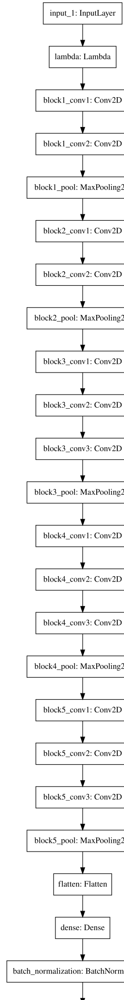

In [0]:
from IPython.display import SVG
from tensorflow.python.keras.utils.vis_utils import model_to_dot

SVG(model_to_dot(model).create(prog='dot', format='svg'))

# 学習

### train_target の内容　要検討

In [0]:
modelpath = '/content/drive/My Drive/Colab Notebooks/data/models/baseline.h5'
callbacks = [
    EarlyStopping(monitor='val_loss', patience=50),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=30),
    ModelCheckpoint(filepath=modelpath, monitor='val_total_acc', save_best_only=True)
]
batch_size=64
epochs = 5000
model.fit_generator(train_generator(x_tra, y_tra, batch_size),
                    steps_per_epoch=len(x_train)//batch_size,
                    epochs=epochs,
                    validation_data=val_generator(x_val, y_val, batch_size),
                    validation_steps=len(x_val)//batch_size,
                    callbacks=callbacks,
                    verbose=2)
# model.fit(x_train, y_train_ohe,
#           batch_size=128, epochs=1000, verbose=1, validation_split=0.1, callbacks=callbacks)

Epoch 1/5000
Epoch 1/5000
62/62 - 65s - loss: 32.2940 - total_acc: 0.0010 - binary_acc: 0.9626 - val_loss: 82.7933 - val_total_acc: 0.0000e+00 - val_binary_acc: 0.9803
Epoch 2/5000
Epoch 1/5000
62/62 - 58s - loss: 20.0444 - total_acc: 5.1020e-04 - binary_acc: 0.9815 - val_loss: 27.6843 - val_total_acc: 0.0000e+00 - val_binary_acc: 0.9767
Epoch 3/5000
Epoch 1/5000
62/62 - 59s - loss: 19.8497 - total_acc: 0.0015 - binary_acc: 0.9814 - val_loss: 25.4747 - val_total_acc: 0.0000e+00 - val_binary_acc: 0.9764
Epoch 4/5000
Epoch 1/5000
62/62 - 59s - loss: 19.3750 - total_acc: 0.0010 - binary_acc: 0.9815 - val_loss: 24.4295 - val_total_acc: 0.0000e+00 - val_binary_acc: 0.9777
Epoch 5/5000
Epoch 1/5000
62/62 - 58s - loss: 19.1517 - total_acc: 0.0010 - binary_acc: 0.9814 - val_loss: 21.6047 - val_total_acc: 0.0000e+00 - val_binary_acc: 0.9802
Epoch 6/5000
Epoch 1/5000
62/62 - 58s - loss: 18.6636 - total_acc: 0.0018 - binary_acc: 0.9816 - val_loss: 21.8859 - val_total_acc: 0.0000e+00 - val_binary_

# 精度確認

In [10]:
model = load_model('/content/drive/My Drive/Colab Notebooks/data/models/baseline.h5',
                   custom_objects={'binary_loss': binary_loss, 'total_acc': total_acc, 'binary_acc': binary_acc})

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
(?, ?)
(?, 266)


## test データ IoU 確認

In [0]:
# train
from PIL import Image
def predict(x, model):
    resize_x = np.zeros((x.shape[0], 224,224,3))
    for i, img in enumerate(x):
        print(img.shape)
        img = Image.fromarray(img).resize((224,224))
        resize_x[i] = np.asarray(img)

    print(resize_x.shape)
    preds = model.predict(resize_x)
    return preds

def calc_iou(x, y, model):
    preds = model.predict(x)
    #preds = predict(x, model)
    iou_list = []
    for i, (pred, true_list) in tqdm(enumerate(zip(preds, x))):
        # [TODO] : 予測させる単語の確率
        indexes = np.where(pred > 0.2)[0]
        print(indexes)
        pred_words = [detokenizer[idx+1] for idx in indexes]
        true_words = [detokenizer[idx] for idx in y[i] if idx != 0]
        # for idx in indexes:
        #     pred_words.append(tokenizer.index_word[idx+1])
        #     #true_words.append(test_tokenizer.index_word[])
        print(f'---------------- img{i} ----------------')
        print('pred words: ', pred_words)
        print('true_words: ', true_words)
        
        num_i = len(set(pred_words) & set(true_words))
        num_u = len(set(pred_words) | set(true_words))
        iou_list.append(num_i / num_u)

        #plt.imshow(x[i]/255.)
        #plt.show()
    print('Total IoU: {}'.format(np.mean(iou_list)))
#calc_iou(x_train, y_train, model)

In [14]:
calc_iou(x_test, y_test, model)

60it [00:00, 595.60it/s]

[ 1 10 11 13 17 23 27 48 76]
---------------- img0 ----------------
pred words:  ['塩', '黒胡椒', '玉ねぎ', 'マヨネーズ', '酢', 'キュウリ', '鶏肉', 'エビ', 'ブロッコリー']
true_words:  ['鶏肉', '卵', '黒胡椒', '片栗粉']
[  0   4   5 135]
---------------- img1 ----------------
pred words:  ['醤油', 'ゴマ油', 'みりん', 'かぼちゃ']
true_words:  ['みりん', '醤油', 'ゴマ油', 'かぼちゃ']
[  1   9  23  47 124]
---------------- img2 ----------------
pred words:  ['塩', 'オリーブオイル', 'キュウリ', '鷹の爪', 'ガーリックパウダー']
true_words:  ['ガーリックパウダー', 'マジックソルト', '鷹の爪', 'オリーブオイル', 'イカ', 'ピーマン']
[ 1  9 28 72 73]
---------------- img3 ----------------
pred words:  ['塩', 'オリーブオイル', 'ゴマ', 'オイスターソース', 'ハム']
true_words:  ['生姜', 'ニラ', '醤油', 'ニンニク', '豚肉', '砂糖', 'オイスターソース', 'ゴマ油']
[7]
---------------- img4 ----------------
pred words:  ['ねぎ']
true_words:  ['レモン', 'オリーブ油', '生姜', 'こしょう', '塩', '唐辛子']
[  1  12  18  24  40 129 143]
---------------- img5 ----------------
pred words:  ['塩', '卵', 'チーズ', 'こしょう', 'オリーブ油', 'ピザ生地', 'ガーリックソルト']
true_words:  ['マヨネーズ', 'ベーコン', 'チーズ', 'じゃがいも', 'ガ

182it [00:00, 599.75it/s]

[ 0  3  6  8 12 15 16 27 32 64]
---------------- img120 ----------------
pred words:  ['醤油', 'ニンニク', '生姜', '塩コショウ', '卵', 'サラダ油', '片栗粉', '鶏肉', '小麦粉', 'パン粉']
true_words:  ['ゴマ', 'ポン酢']
[ 0  1  6 58 85]
---------------- img121 ----------------
pred words:  ['醤油', '塩', '生姜', 'クリームチーズ', '海苔']
true_words:  ['魚肉ソーセージ', 'ピーマン', '天ぷら粉']
[ 0  1  5  6  7 22 92]
---------------- img122 ----------------
pred words:  ['醤油', '塩', 'みりん', '生姜', 'ねぎ', '味噌', '山椒']
true_words:  ['こしょう', 'ニンニク', '塩', 'ゴマ油', 'サラダ油']
[ 1  8  9 49]
---------------- img123 ----------------
pred words:  ['塩', '塩コショウ', 'オリーブオイル', '白ワイン']
true_words:  ['マヨネーズ', 'ハム', 'レモン', 'キュウリ', '醤油', 'じゃがいも', '塩', '塩コショウ', '玉ねぎ']
[ 0  7 11]
---------------- img124 ----------------
pred words:  ['醤油', 'ねぎ', '玉ねぎ']
true_words:  ['一味唐辛子', 'ゴマ油', '黒胡椒']
[]
---------------- img125 ----------------
pred words:  []
true_words:  ['白ごま', 'しめじ', 'ポン酢', '豚肉', 'ゴマ油']
[  0  79 155]
---------------- img126 ----------------
pred words:  ['醤油', 'マグロ', 'マスタード

309it [00:00, 613.62it/s]

[  0   4   6  88 107]
---------------- img241 ----------------
pred words:  ['醤油', 'ゴマ油', '生姜', 'パクチー', 'カイワレ']
true_words:  ['黒胡椒', 'スパゲッティ', 'レモン', '醤油', '鱈子', 'バター', '玉ねぎ']
[  1   2   9  18  40  44 174 252]
---------------- img242 ----------------
pred words:  ['塩', '砂糖', 'オリーブオイル', 'チーズ', 'オリーブ油', 'ベーコン', '強力粉', 'インスタントドライイースト']
true_words:  ['インスタントドライイースト', 'オリーブ油', 'ベーコン', 'チーズ', '砂糖', '塩', '強力粉']
[  0   1  85 121]
---------------- img243 ----------------
pred words:  ['醤油', '塩', '海苔', '菜種油']
true_words:  ['オリーブ油', '塩']
[  0  12  18 130]
---------------- img244 ----------------
pred words:  ['醤油', '卵', 'チーズ', 'ズッキーニ']
true_words:  ['サワークリーム', 'シイタケ']
[25]
---------------- img245 ----------------
pred words:  ['大根']
true_words:  ['マヨネーズ', '青じそ', 'かまぼこ']
[ 1 14]
---------------- img246 ----------------
pred words:  ['塩', 'だしの素']
true_words:  ['オリーブ油', '卵', 'カレー粉', 'パン粉', '塩コショウ']
[  0   1   7  41  93 103]
---------------- img247 ----------------
pred words:  ['醤油', '塩', 'ねぎ', '刺身'

440it [00:00, 630.96it/s]


true_words:  ['大葉', '刺身', '生姜', '醤油', 'ムツ', '茗荷']
[  0   6   9  35  41  45  81  96 213]
---------------- img375 ----------------
pred words:  ['醤油', '生姜', 'オリーブオイル', '大葉', '刺身', 'イカ', '茗荷', 'ムツ', '塩辛']
true_words:  ['ねぎ', 'ナンプラー', '大葉', '刺身', '生姜', '醤油']
[  1  47 102 131]
---------------- img376 ----------------
pred words:  ['塩', '鷹の爪', '枝豆', '焼肉のたれ']
true_words:  ['枝豆', '塩']
[  0   2   5   6   7  11  14  22  25  26  67 139]
---------------- img377 ----------------
pred words:  ['醤油', '砂糖', 'みりん', '生姜', 'ねぎ', '玉ねぎ', 'だしの素', '味噌', '大根', 'にんじん', '一味唐辛子', '牛肉']
true_words:  ['みりん', '一味唐辛子', 'ねぎ', '鷹の爪', '醤油', '砂糖', '牛肉']
[ 1 14 25]
---------------- img378 ----------------
pred words:  ['塩', 'だしの素', '大根']
true_words:  ['天ぷら粉']
[ 1 20 23]
---------------- img379 ----------------
pred words:  ['塩', '日本酒', 'キュウリ']
true_words:  ['キュウリ', '日本酒', '大根', '塩', '片栗粉']
[ 0  1  2  4 14 17]
---------------- img380 ----------------
pred words:  ['醤油', '塩', '砂糖', 'ゴマ油', 'だしの素', '酢']
true_words:  ['ねぎ', 

566it [00:00, 627.82it/s]


[1]
---------------- img502 ----------------
pred words:  ['塩']
true_words:  ['アサリ', '小ねぎ', '醤油', '豆腐', '大根']
[ 5 80]
---------------- img503 ----------------
pred words:  ['みりん', '鮭']
true_words:  ['大葉', '刺身', '生姜', '醤油', '鯵', '味噌', '玉ねぎ']
[ 1 16]
---------------- img504 ----------------
pred words:  ['塩', '片栗粉']
true_words:  ['キャベツ', 'ゴマ油', '塩昆布']
[33 58]
---------------- img505 ----------------
pred words:  ['トマト', 'クリームチーズ']
true_words:  ['トマト', 'クリームチーズ', 'オリーブオイル']
[ 0  1  4 93]
---------------- img506 ----------------
pred words:  ['醤油', '塩', 'ゴマ油', '白菜']
true_words:  ['菜種油', '日本酒', 'オイスターソース', '塩', '片栗粉']
[  1  21 192 253]
---------------- img507 ----------------
pred words:  ['塩', 'レモン', 'せり', 'チリソース']
true_words:  ['チリソース', 'レモン']
[ 0  1  7 10 13 18 73]
---------------- img508 ----------------
pred words:  ['醤油', '塩', 'ねぎ', '黒胡椒', 'マヨネーズ', 'チーズ', 'ハム']
true_words:  ['みりん', '醤油', 'しそ', '塩', '長芋', 'だしの素', 'マグロ']
[ 1 11 74 78 93]
---------------- img509 ----------------
pred wo

720it [00:01, 624.41it/s]

[ 0 17 45]
---------------- img630 ----------------
pred words:  ['醤油', '酢', 'イカ']
true_words:  ['わさび', 'ねぎ', '塩コショウ', 'サラダ油']
[ 0 35 38 41]
---------------- img631 ----------------
pred words:  ['醤油', '大葉', 'わさび', '刺身']
true_words:  ['みりん', '味噌', '大根']
[ 0  2  5 15]
---------------- img632 ----------------
pred words:  ['醤油', '砂糖', 'みりん', 'サラダ油']
true_words:  ['みりん', '味噌', '砂糖', 'ゴマ', 'サラダ油']
[ 0  1  2  5 14 20 72]
---------------- img633 ----------------
pred words:  ['醤油', '塩', '砂糖', 'みりん', 'だしの素', '日本酒', 'オイスターソース']
true_words:  ['じゃがいも', '麺つゆ', '砂糖']
[2 5]
---------------- img634 ----------------
pred words:  ['砂糖', 'みりん']
true_words:  ['生姜', '鯖', 'シークワーサー', 'みりん']
[ 0  1  2 38 41 53]
---------------- img635 ----------------
pred words:  ['醤油', '塩', '砂糖', 'わさび', '刺身', 'ケチャップ']
true_words:  ['大葉', 'ご飯', 'ニンニク', '味噌', 'ゴマ油']
[  1   9  10  82 260]
---------------- img636 ----------------
pred words:  ['塩', 'オリーブオイル', '黒胡椒', 'タコ', 'つぶ貝']
true_words:  ['レタス', '竹輪', 'コーン', 'マヨネーズ']
[ 0 

img 0: ['塩', '黒胡椒', '玉ねぎ', 'マヨネーズ', '酢', 'キュウリ', '鶏肉', 'エビ', 'ブロッコリー']


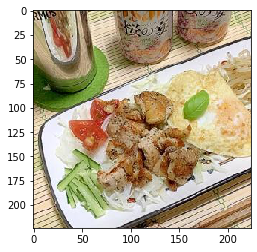

img 1: ['醤油', 'ゴマ油', 'みりん', 'かぼちゃ']


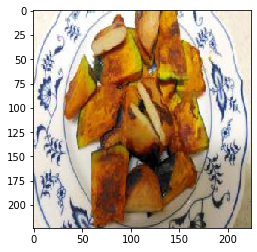

img 2: ['塩', 'オリーブオイル', 'キュウリ', '鷹の爪', 'ガーリックパウダー']


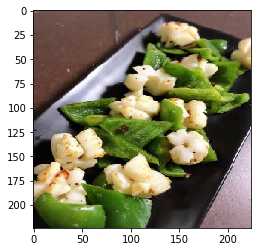

img 3: ['塩', 'オリーブオイル', 'ゴマ', 'オイスターソース', 'ハム']


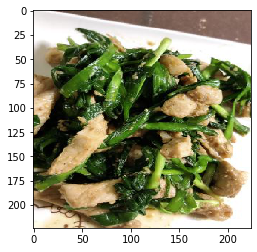

img 4: ['ねぎ']


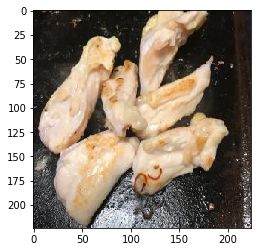

img 5: ['塩', '卵', 'チーズ', 'こしょう', 'オリーブ油', 'ピザ生地', 'ガーリックソルト']


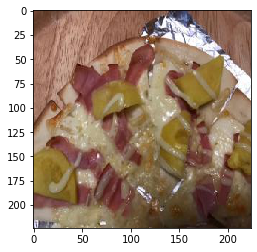

img 6: ['醤油', '塩', '砂糖', 'ニンニク', 'みりん', '生姜', 'ねぎ']


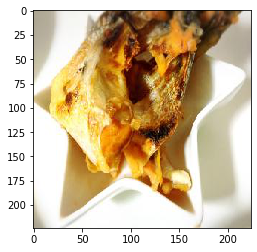

img 7: ['醤油', 'ゴマ油', 'みりん', 'ねぎ', '豆腐', 'オリーブ油', '豚肉', '白菜']


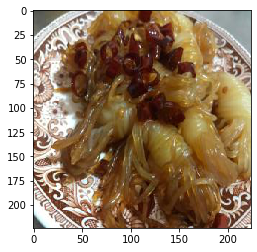

img 8: ['醤油', '砂糖', '生姜']


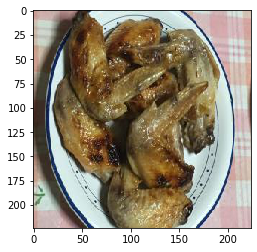

img 9: ['醤油', '塩', '砂糖', 'みりん', '卵', 'だしの素', '酢']


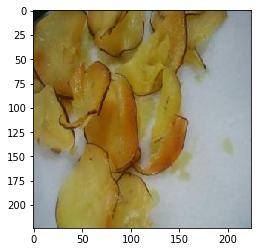

img 10: ['醤油', '生姜', 'バター', 'ピーマン', 'ホタテ']


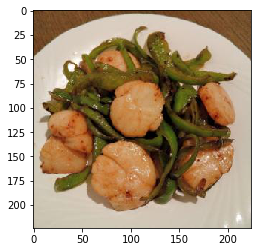

img 11: ['塩', '片栗粉', '小麦粉', '豆腐', '山椒']


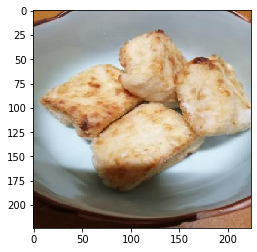

img 12: ['醤油', '塩', '砂糖', 'みりん', '酢', 'アスパラガス']


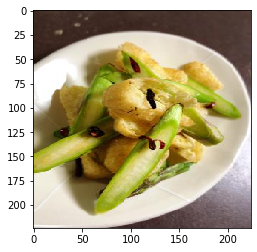

img 13: ['醤油', '塩', 'ゴマ油', 'みりん', '生姜', '酢', 'キュウリ', '白菜']


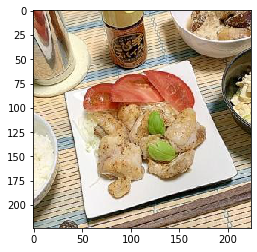

img 14: ['醤油', '塩', '砂糖', '生姜', 'ねぎ', 'カイワレ']


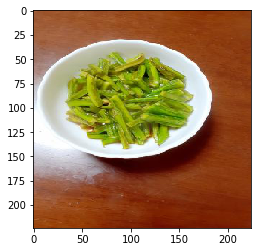

img 15: ['塩', 'オリーブオイル', 'にんじん', 'キャベツ', 'ソーセージ']


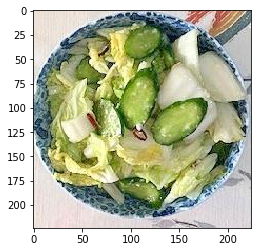

img 16: ['塩', 'みりん', 'だしの素', 'サラダ油', '片栗粉', '日本酒', 'ごぼう', '本つゆ']


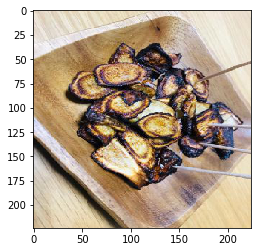

img 17: ['醤油', '酢']


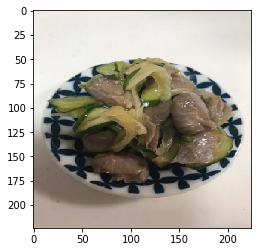

img 18: ['醤油', '塩', '砂糖', 'ニンニク', '酢']


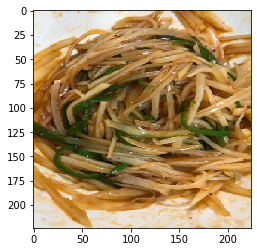

img 19: ['とろけるチーズ', '海苔', '長芋', '柿', '山芋']


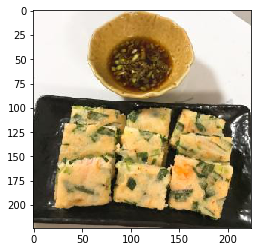

img 20: ['ゴマ油', 'ねぎ', '卵', '鰹節', 'キャベツ']


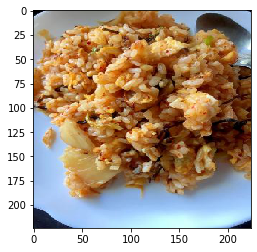

img 21: ['醤油', '塩', '生姜']


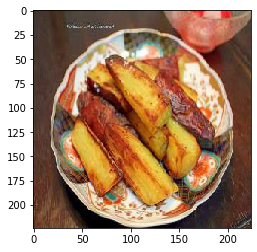

img 22: ['塩', 'ニンニク', '卵', 'サラダ油', '片栗粉', '揚げ油', '小麦粉']


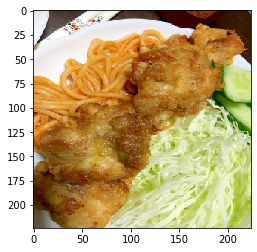

img 23: ['塩', '日本酒', '柚子', '河豚']


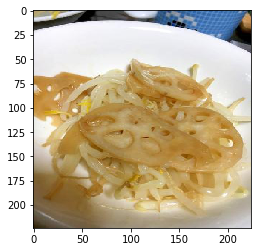

img 24: ['醤油', '刺身', '一味唐辛子', 'ムツ']


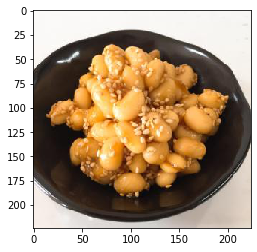

img 25: ['醤油', '塩', 'ラー油', '豆苗']


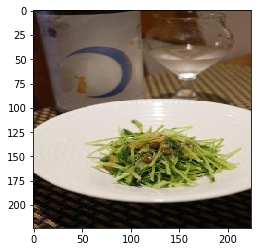

img 26: ['醤油', '卵', 'だしの素', '豆腐', '青じそ']


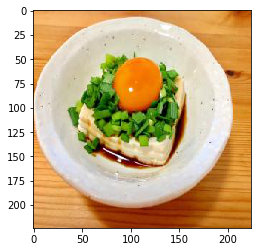

img 27: ['醤油', '塩', 'みりん', '日本酒', '味噌', '柚子']


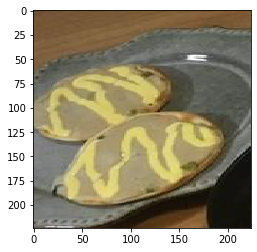

img 28: ['塩', 'ニンニク', 'ゴマ油', '塩コショウ', 'オリーブオイル', 'キュウリ', 'こしょう', 'ゴマ']


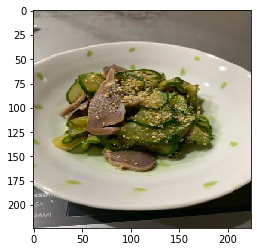

img 29: ['塩', 'オリーブオイル', '麺つゆ', '鰹節', '刺身']


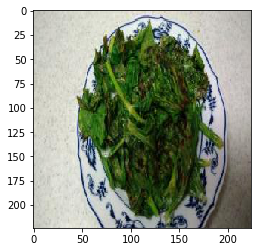

img 30: ['醤油', '塩', '卵', '片栗粉', '日本酒', '白子', 'オイスターソース', '豆乳', 'かぶ']


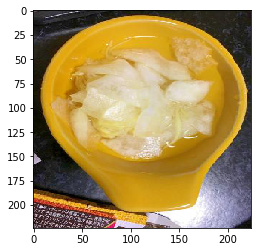

img 31: ['塩', '黒胡椒']


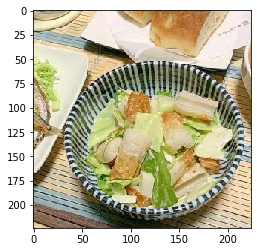

img 32: ['醤油', '塩']


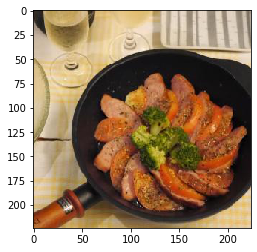

img 33: ['塩', '塩コショウ', 'オリーブオイル', '黒胡椒', 'ゴマ', 'キャベツ', '鶏ガラスープの素', 'パスタ', 'もやし']


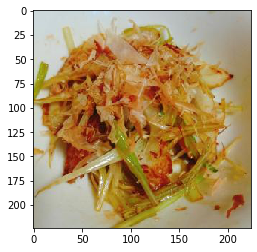

img 34: ['醤油', '塩', '生姜', 'ねぎ', '黒胡椒', '片栗粉', '鶏ガラスープの素']


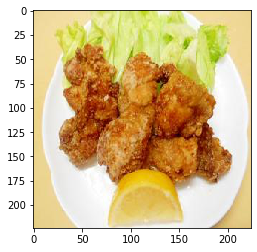

img 35: ['塩', '黒胡椒', 'キュウリ']


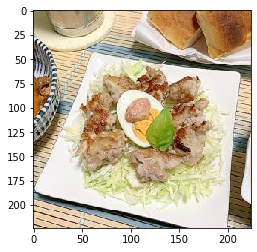

img 36: ['醤油', 'ねぎ', 'シイタケ']


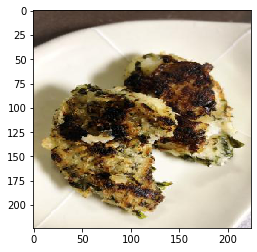

img 37: ['醤油', '塩', '砂糖', 'マヨネーズ']


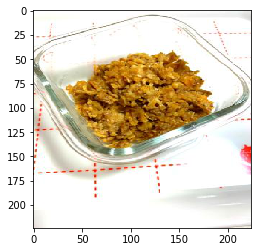

img 38: ['醤油', '塩', '砂糖', 'みりん', '酢', 'キュウリ', '料理酒']


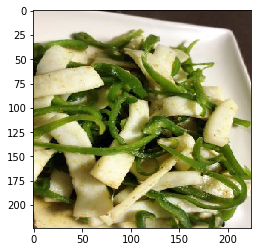

img 39: ['醤油', '塩', '砂糖', 'みりん']


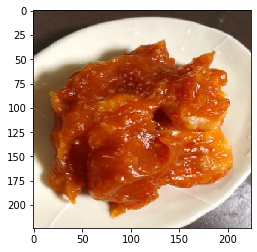

img 40: ['塩', 'ゴマ油', 'オリーブオイル', '玉ねぎ', 'マヨネーズ', '鰹節', 'イカ', 'キャベツ', '青海苔', '鰹']


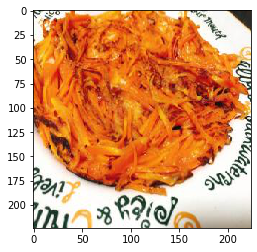

img 41: ['醤油', '砂糖', 'みりん', '生姜', 'ねぎ', 'サラダ油']


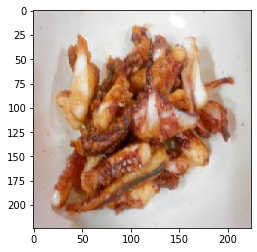

img 42: ['醤油', '生姜', '大根']


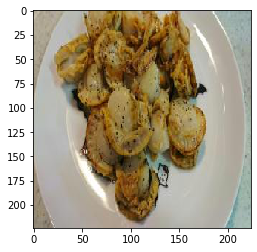

img 43: ['生姜', 'ポン酢']


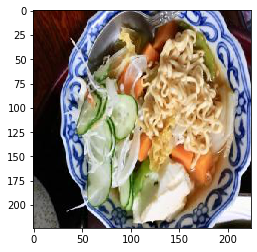

img 44: ['醤油', '塩', 'ゴマ油', 'ねぎ', '砂肝', 'ラー油']


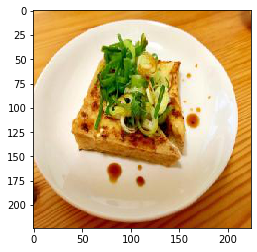

img 45: ['醤油', 'みりん']


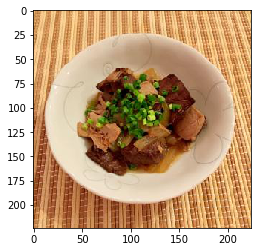

img 46: ['醤油', '塩']


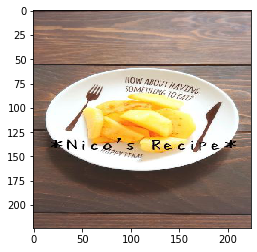

img 47: ['刺身', 'イカ', '茗荷', 'パクチー', '塩辛']


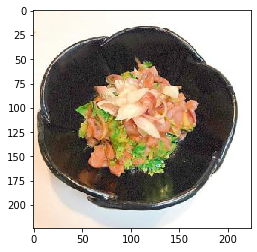

img 48: ['醤油', '生姜', 'イカ', '茗荷']


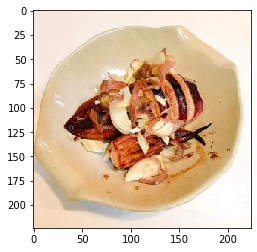

img 49: ['塩', '日本酒', 'レンコン', 'なんこつ']


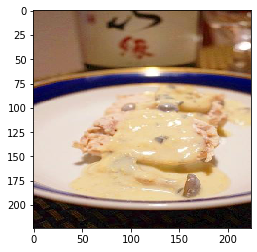

img 50: ['塩', '卵', '日本酒', 'ご飯', '粉チーズ', 'ホタテ']


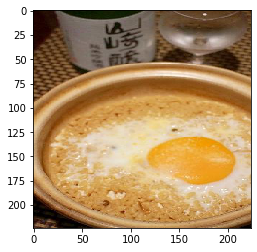

img 51: ['醤油', 'オリーブオイル', '玉ねぎ', '卵', 'わさび']


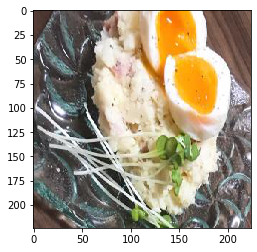

img 52: ['塩', 'マヨネーズ', '豆腐']


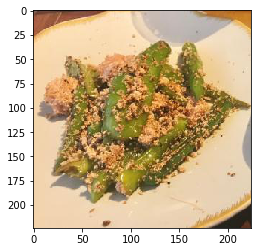

img 53: ['塩', '砂糖']


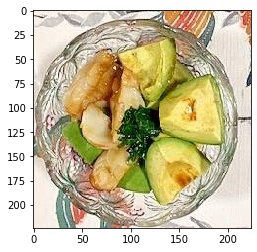

img 54: ['醤油', '塩', 'オリーブオイル', '刺身', 'カイワレ']


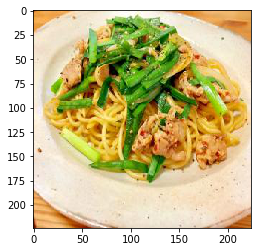

img 55: ['醤油', '塩', 'ねぎ', '黒胡椒']


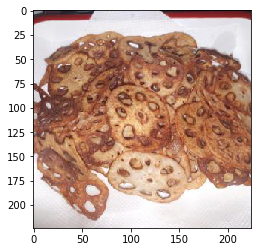

img 56: ['塩', 'みりん', 'オリーブオイル', '黒胡椒', '粉チーズ']


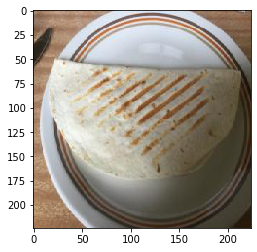

img 57: ['塩', 'ニンニク', 'オリーブオイル', '玉ねぎ', 'こしょう', 'にんじん', 'コンソメ', 'レンコン']


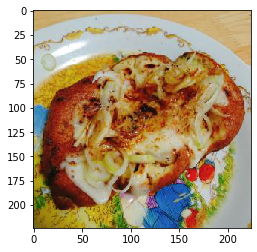

img 58: ['塩', 'ニンニク', 'こしょう', 'マジックソルト']


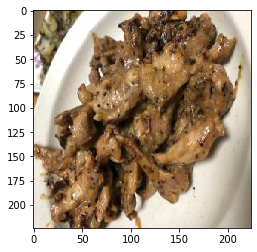

img 59: ['塩', '生姜', 'ねぎ', '鰹節', '厚揚げ']


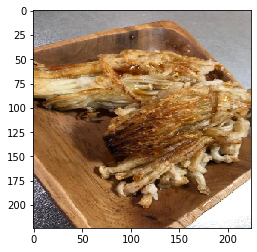

img 60: ['塩', '生姜']


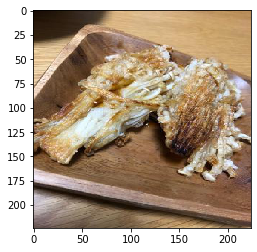

img 61: ['塩', '砂糖', 'だしの素', '酢', 'キュウリ', '本つゆ']


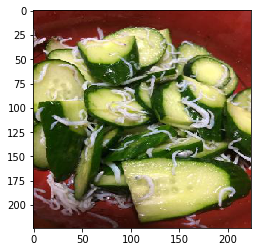

img 62: ['塩', 'ゴマ油', 'トマト', 'ポン酢', 'わさび', '牡蠣']


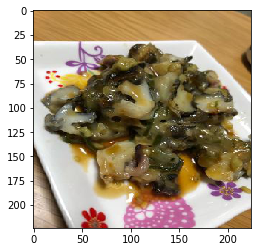

img 63: ['塩', 'みりん', '生姜', 'ねぎ', '片栗粉', '日本酒', '味噌', 'ご飯', '餃子の皮', 'オイスターソース', 'こめ油']


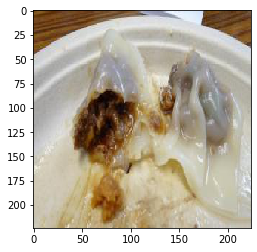

img 64: ['醤油', '砂糖', 'みりん', '生姜', '大根']


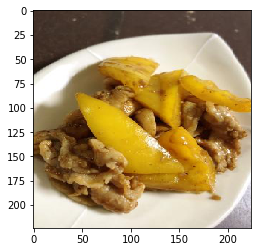

img 65: ['醤油', '塩', 'オリーブオイル']


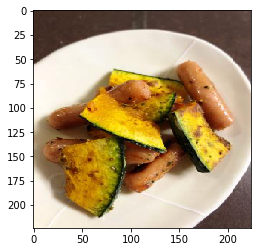

img 66: ['塩', 'ニンニク', 'オリーブオイル', 'レモン', 'じゃがいも', 'トマト', 'ピーマン']


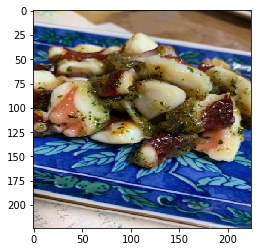

img 67: ['塩', '生姜', 'ねぎ', '黒胡椒', '鰹節']


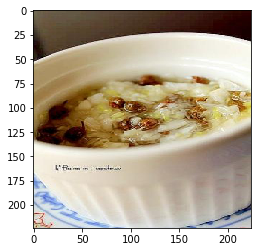

img 68: ['ねぎ', '揚げ油']


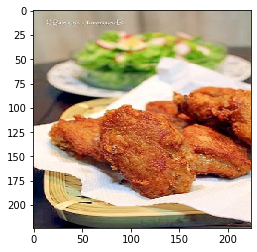

img 69: ['醤油', '塩', '砂糖', 'みりん', 'だしの素', '大根', 'にんじん']


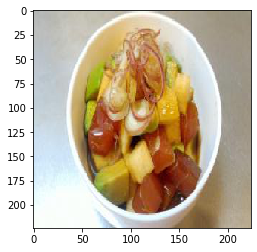

img 70: ['塩', 'ゴマ油', '生姜', '酢', '秋刀魚']


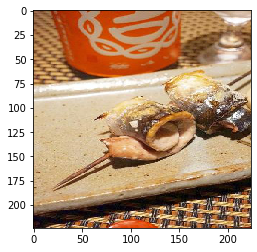

img 71: ['醤油', '塩', '生姜', 'オリーブオイル', '鰆']


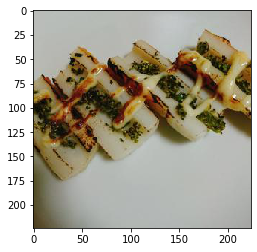

img 72: ['醤油', '塩', 'みりん', '味の素']


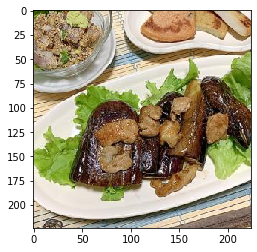

img 73: ['醤油', '塩', 'ねぎ', '日本酒']


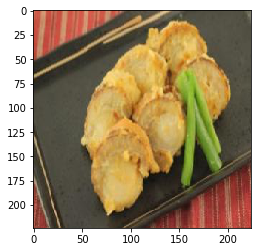

img 74: ['醤油', '塩', 'ゴマ油', '生姜', 'ゴマ']


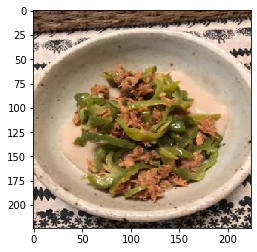

img 75: ['醤油', '塩', 'みりん', '卵', 'だしの素', '白子', '湯葉']


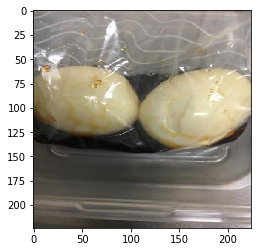

img 76: ['醤油', 'ゴマ油', 'キュウリ', 'オリーブ油', '茗荷', '小松菜']


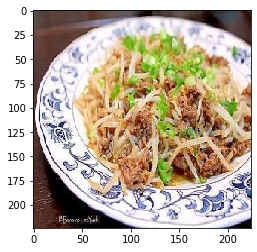

img 77: ['醤油', '砂糖', 'ゴマ油']


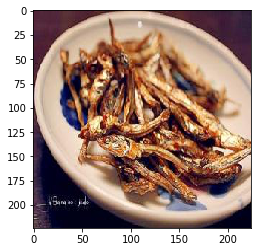

img 78: ['塩', 'ゴマ油', 'みりん', '厚揚げ', 'だし醤油']


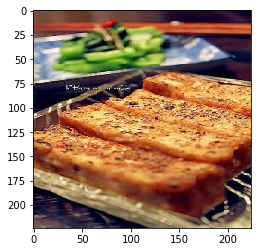

img 79: ['塩', '黒胡椒', 'クリームチーズ']


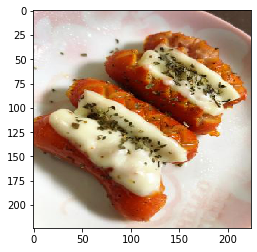

img 80: ['醤油', 'ゴマ油', '酢']


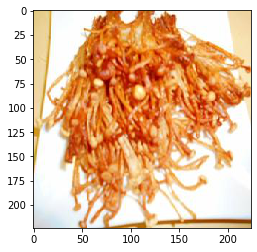

img 81: ['醤油', '砂糖', 'ゴマ油', 'みりん', '玉ねぎ', 'にんじん', '鶏ガラスープの素', 'ラー油', '刻みネギ']


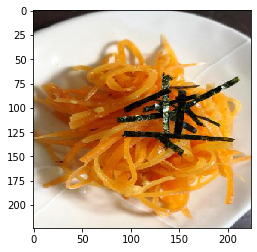

img 82: ['醤油', '砂糖', 'ニンニク', 'みりん', '生姜', '卵']


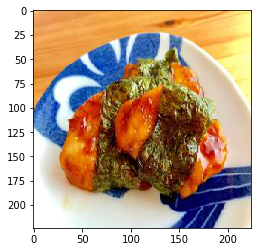

img 83: ['醤油', '砂糖', 'みりん', 'サラダ油', '舞茸']


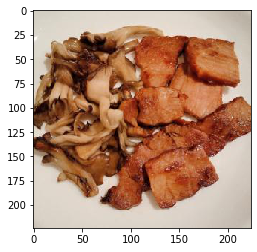

img 84: ['ねぎ', 'マヨネーズ', '粒マスタード', 'ピザ生地']


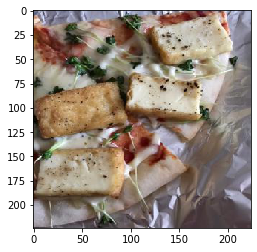

img 85: ['塩', '味噌', 'こしょう', 'オリーブ油', 'キャベツ', '砂肝', '酒粕', '鯵', 'ピザ生地']


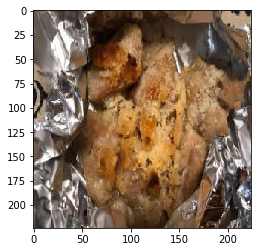

img 86: ['砂糖', 'ピーマン', '鶏ガラスープの素']


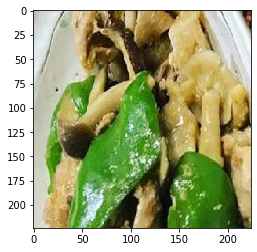

img 87: ['塩コショウ', '天ぷら粉', '胸肉']


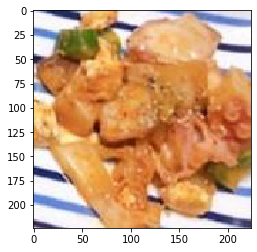

img 88: ['醤油', '生姜', 'ねぎ', '砂肝']


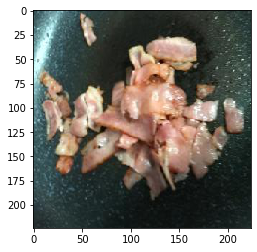

img 89: ['醤油', '塩', '砂糖', 'みりん', '日本酒', '大根']


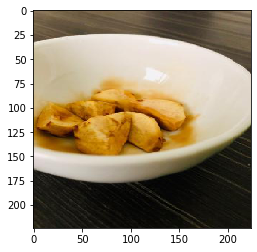

img 90: ['醤油', '塩', '生姜', 'ゴマ', '刺身']


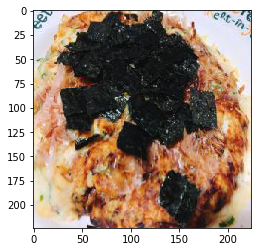

img 91: ['醤油', '塩', 'ニンニク', 'みりん', '塩コショウ', 'サラダ油', '片栗粉', '鶏肉', '小麦粉', 'タコ']


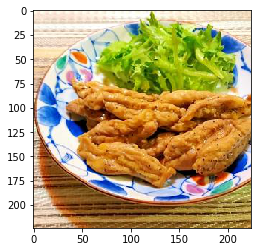

img 92: ['醤油', '玉ねぎ', 'サラダ油', '刺身', 'イカ', 'ムツ', '塩辛', '魚肉ソーセージ']


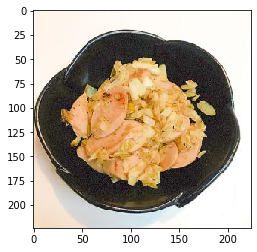

img 93: ['醤油', 'ねぎ', '酢', 'パクチー', '鰹のたたき']


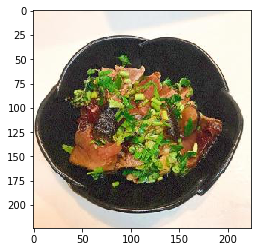

img 94: ['塩', 'みりん', '生姜', 'ねぎ', 'だしの素', '味噌', 'えのき', '鶏むね肉', '薄口醤油']


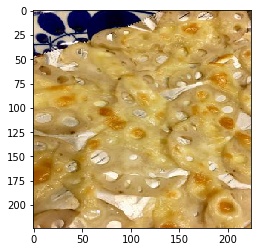

img 95: ['醤油', '塩', 'だしの素']


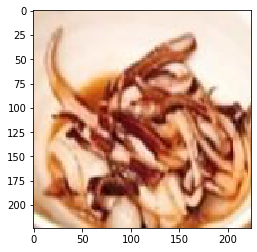

img 96: ['醤油', '玉ねぎ', 'わさび', '刺身', 'イカ', 'ムツ', '塩辛']


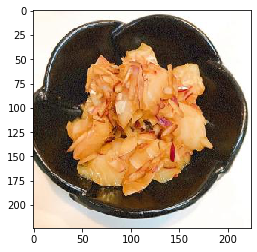

img 97: ['醤油', 'ねぎ', '酢', 'パセリ', 'イカ', '塩辛']


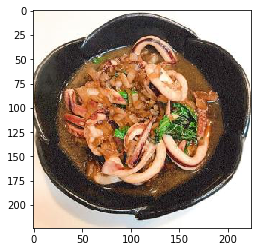

img 98: ['醤油', '塩', 'マヨネーズ', 'オイスターソース', 'ホタテ', '水菜']


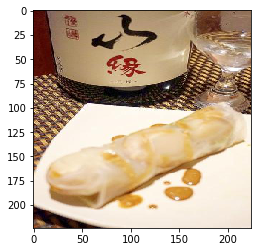

img 99: ['醤油', '塩', 'オリーブオイル', '日本酒', '大根']


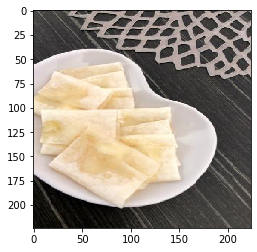

img 100: ['塩', '揚げ油', '天ぷら粉']


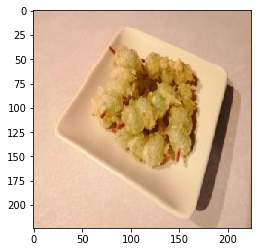

img 101: ['砂糖', 'ニンニク', 'ゴマ油', 'キュウリ', 'ゴマ', 'ピーマン', '塩昆布']


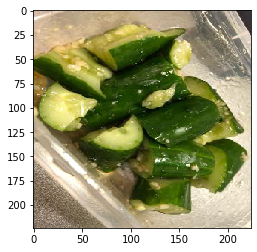

img 102: ['醤油', '塩', 'オリーブオイル']


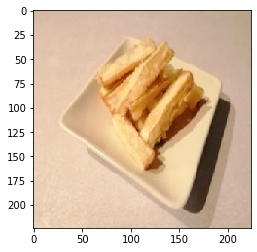

img 103: ['醤油', 'ゴマ油', '生姜', 'わかめ']


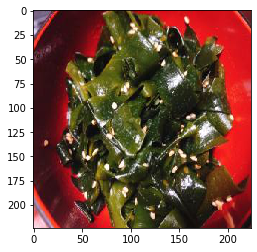

img 104: ['砂糖', 'みりん', '味噌', 'キュウリ']


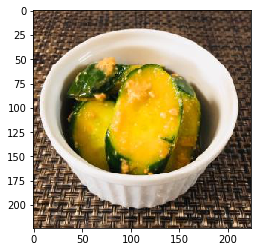

img 105: ['醤油', '塩', 'ゴマ油', 'ねぎ', 'レモン', '砂肝']


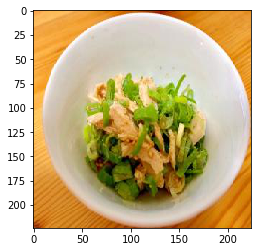

img 106: ['醤油', '砂糖', '塩コショウ', 'オリーブオイル', '酢', 'バター', '小松菜', '舞茸']


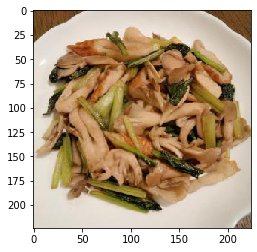

img 107: ['醤油', '塩', 'ゴマ油', 'オリーブオイル', '鶏ガラスープの素']


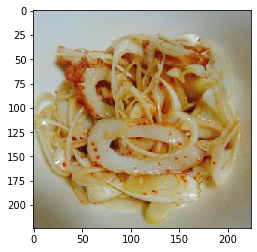

img 108: ['醤油', '塩', 'オリーブオイル', '刺身', 'カイワレ', '鰆']


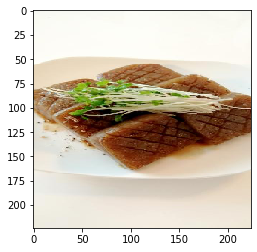

img 109: ['ねぎ', 'オリーブオイル', 'マヨネーズ', '味噌', 'トマト', 'シイタケ', 'ジェノベーゼソース']


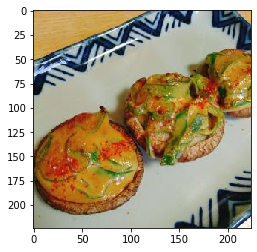

img 110: ['醤油', '砂糖', 'みりん', '生姜']


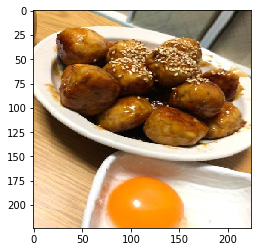

img 111: ['醤油', 'マヨネーズ', 'だしの素', 'わさび']


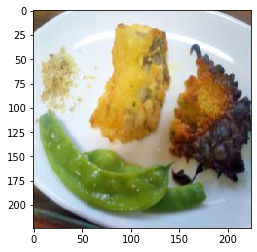

img 112: ['醤油', 'みりん', '玉ねぎ', '酢', '日本酒', 'わさび', '青じそ', 'ししとう', '梅酢']


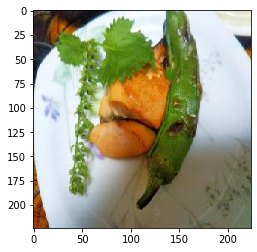

img 113: ['チーズ', 'ケチャップ']


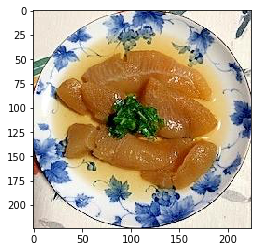

img 114: ['醤油', '砂糖', 'ニンニク', 'みりん', '生姜', '塩コショウ', 'オリーブオイル', 'サラダ油', 'ゴマ', '鶏ひき肉']


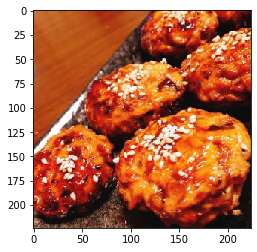

img 115: ['醤油', 'わさび', '油揚げ', '山椒', '鯵', 'カニ']


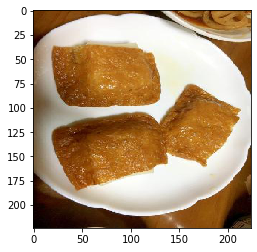

img 116: ['醤油', '塩', '生姜', 'ねぎ', '大根', '鶏肉']


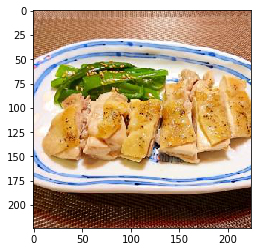

img 117: ['塩', 'オリーブオイル', '黒胡椒', '玉ねぎ', 'チーズ', 'レモン']


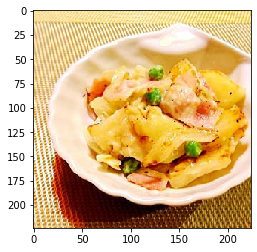

img 118: ['塩', '卵', '片栗粉']


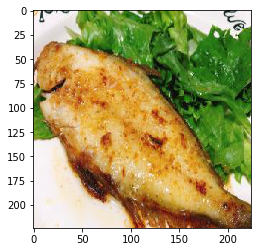

img 119: ['塩', 'オリーブオイル', 'チーズ', '強力粉', '三温糖', 'インスタントドライイースト']


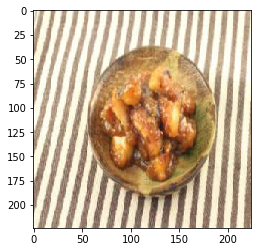

img 120: ['醤油', 'ニンニク', '生姜', '塩コショウ', '卵', 'サラダ油', '片栗粉', '鶏肉', '小麦粉', 'パン粉']


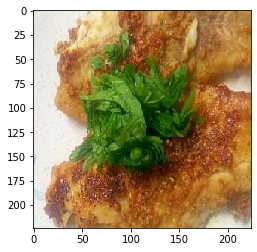

img 121: ['醤油', '塩', '生姜', 'クリームチーズ', '海苔']


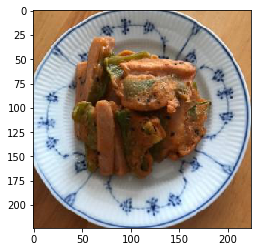

img 122: ['醤油', '塩', 'みりん', '生姜', 'ねぎ', '味噌', '山椒']


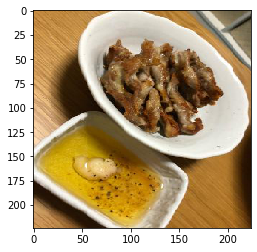

img 123: ['塩', '塩コショウ', 'オリーブオイル', '白ワイン']


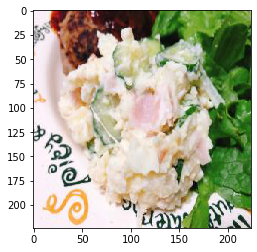

img 124: ['醤油', 'ねぎ', '玉ねぎ']


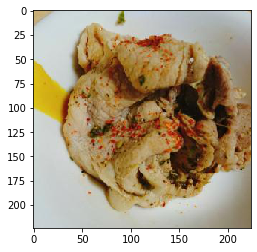

img 125: []


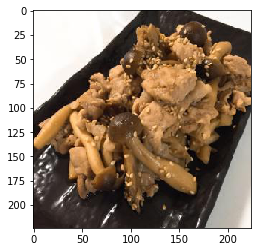

img 126: ['醤油', 'マグロ', 'マスタード']


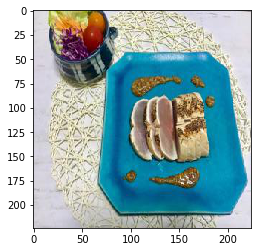

img 127: ['生姜', 'オリーブオイル', '大根', 'にんじん', 'つぶ貝']


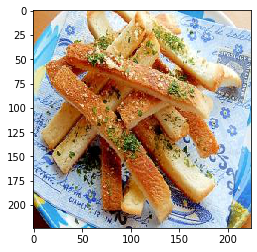

img 128: ['醤油', '塩', 'ニンニク', 'オリーブオイル', 'こしょう', 'わさび', '刺身', 'イナダ']


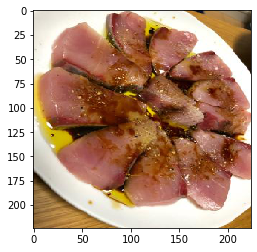

img 129: ['醤油', '生姜', '刺身']


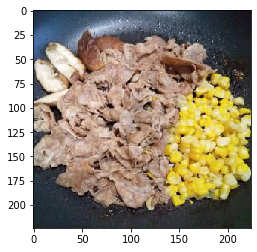

img 130: ['塩', 'チーズ', 'こしょう', 'トマト', 'とろけるチーズ', 'アボカド']


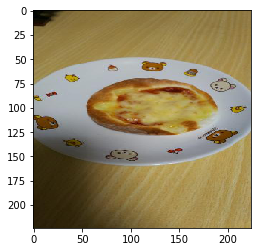

img 131: ['塩', '生姜', 'ねぎ', 'しめじ']


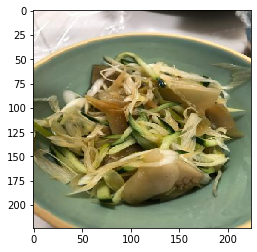

img 132: ['醤油', '塩', 'ニンニク', '生姜', '塩コショウ', 'サラダ油', '片栗粉', 'レモン', '鶏肉', '小麦粉', 'タコ', 'ライム']


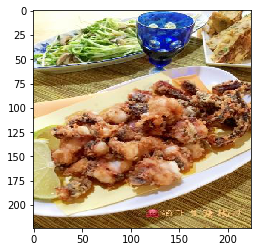

img 133: ['塩', 'ねぎ', 'チーズ', 'とろけるチーズ', 'アボカド', 'バジル']


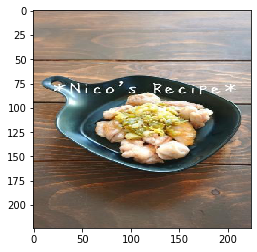

img 134: ['塩', 'ゴマ油', 'ねぎ', '卵']


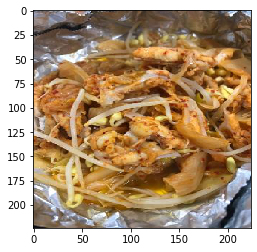

img 135: ['醤油', '塩', 'みりん', '卵', '日本酒', '白子', '柚子']


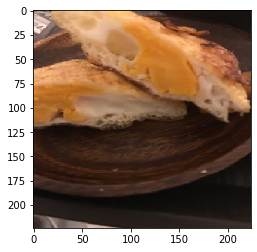

img 136: ['オリーブオイル']


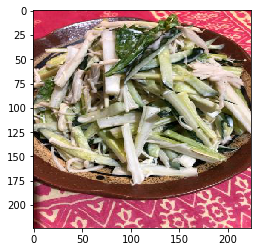

img 137: ['醤油', 'ニンニク', '塩コショウ', '玉ねぎ', '鰹節']


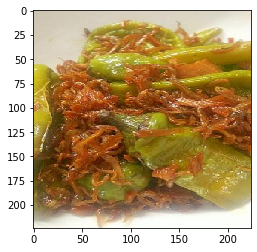

img 138: ['醤油', '塩', 'ニンニク', 'みりん', 'オリーブオイル', 'バター', 'オイスターソース']


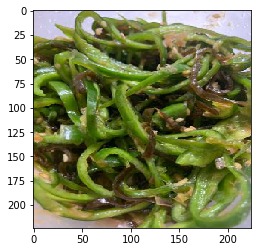

img 139: ['醤油', '塩', '黒胡椒', '海苔', '長芋']


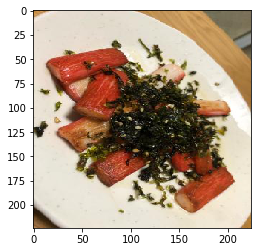

img 140: ['醤油', '塩', 'みりん', '生姜', '日本酒', 'わさび', 'オイスターソース', 'レンコン', '山椒', '鶏むね肉', '柚子こしょう', '秋刀魚', 'イナダ']


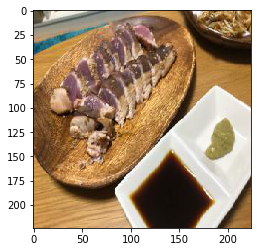

img 141: ['醤油', '砂糖', 'ニンニク', '片栗粉']


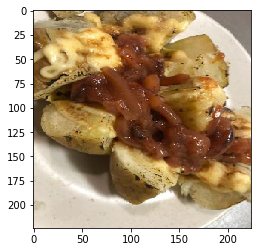

img 142: ['生姜', '卵', '片栗粉', '厚揚げ']


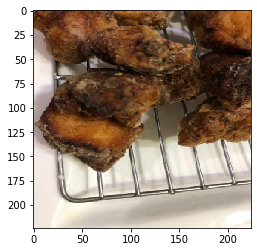

img 143: ['醤油', '塩', 'みりん', '麺つゆ', 'オクラ']


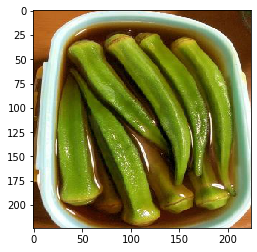

img 144: ['醤油', '塩']


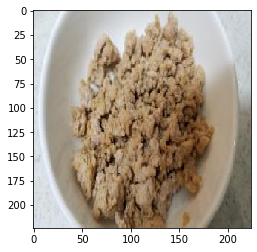

img 145: ['醤油', '塩', 'オリーブオイル', 'マヨネーズ', 'バケット']


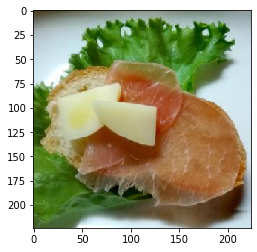

img 146: ['塩', 'オリーブオイル', '玉ねぎ', 'マヨネーズ', 'バケット']


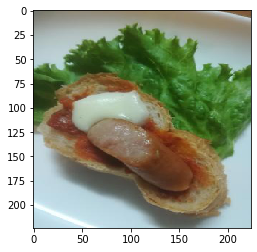

img 147: ['醤油', '塩', '黒胡椒', 'とろけるチーズ', '刺身', 'アボカド']


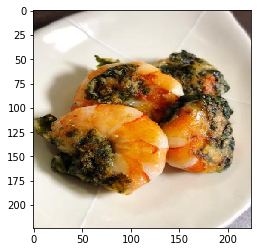

img 148: ['醤油', '塩', 'ゴマ油', 'みりん', 'キュウリ', '一味唐辛子']


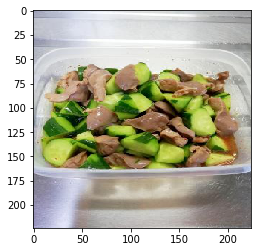

img 149: ['醤油', 'ニンニク', 'ゴマ油', 'みりん', 'キュウリ', '豆板醤']


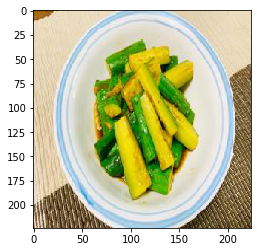

img 150: ['塩', '落花生']


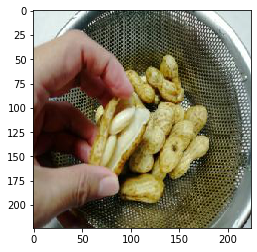

img 151: ['醤油', '塩', 'ねぎ', 'だしの素', '大根', '豆腐']


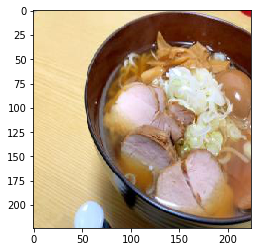

img 152: ['マヨネーズ', '春巻きの皮']


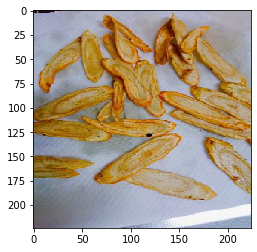

img 153: ['醤油', 'ねぎ', 'イカ', '茗荷', '塩辛']


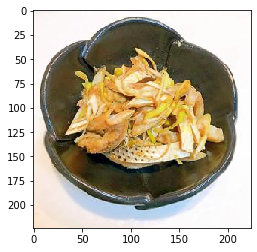

img 154: ['醤油', '卵', 'マヨネーズ', 'レモン', '味噌', 'ガーリックパウダー', '里芋']


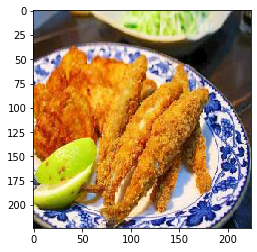

img 155: ['醤油', '塩', 'ゴマ油', '黒胡椒', '玉ねぎ', 'にんじん', '鷹の爪', '鴨']


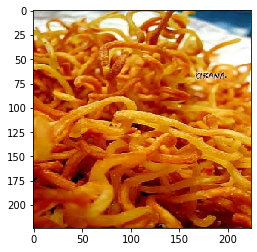

img 156: ['塩', 'レモン', 'ポン酢']


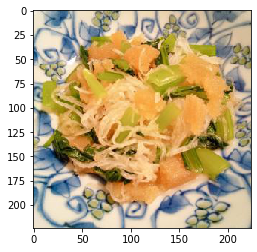

img 157: ['塩', '大葉', '刺身', 'ムツ', '塩麹']


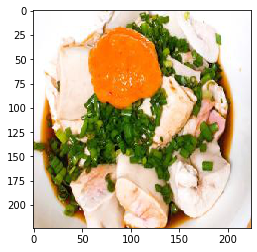

img 158: ['醤油', '塩', 'わさび', '刺身', 'マグロ', '柚子こしょう']


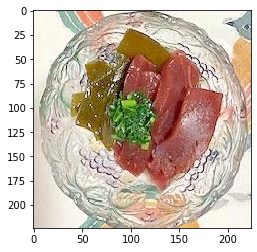

img 159: ['塩', '砂糖', '大根']


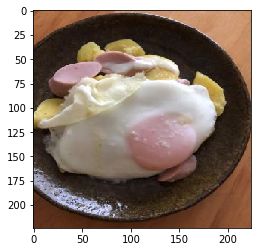

img 160: ['醤油', '塩', 'みりん', '生姜', '卵', '大根', 'にんじん', '麺つゆ', '里芋']


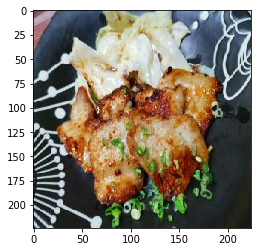

img 161: ['醤油', '塩', 'ゴマ油', 'みりん', '鷹の爪', '唐辛子']


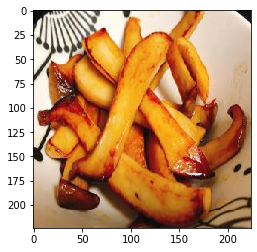

img 162: ['醤油', '砂糖', 'ゴマ油', 'みりん', '鷹の爪', 'ししとう']


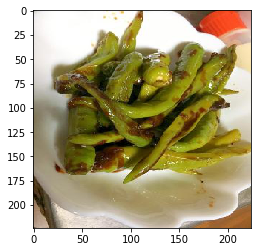

img 163: ['醤油', '塩', 'だしの素', 'サラダ油']


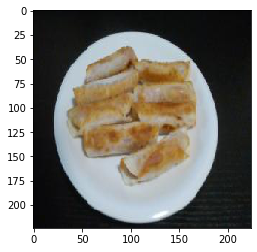

img 164: ['塩', '砂糖', 'だしの素', '酢', 'キュウリ', '大根', 'わかめ', '本つゆ']


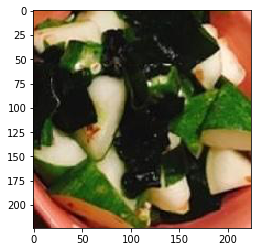

img 165: ['塩', 'チーズ']


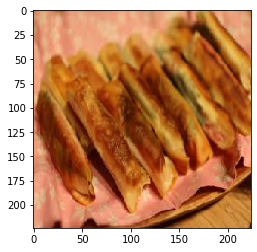

img 166: ['醤油', '砂糖', 'ゴマ油', 'みりん', '黒胡椒', '大葉', 'こんにゃく']


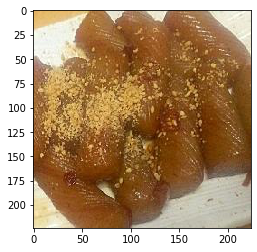

img 167: ['オリーブオイル', '黒胡椒', 'チーズ', 'トマト', '餃子の皮', 'バジル']


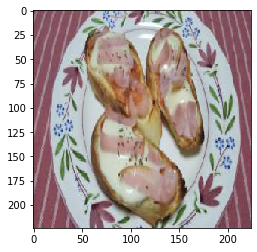

img 168: ['醤油', '塩', '酢', 'わさび', '刺身', 'イカ', 'マグロ']


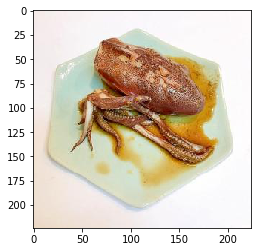

img 169: ['塩コショウ', 'オリーブオイル', '玉ねぎ', 'オリーブ油', 'ケチャップ', 'パン粉']


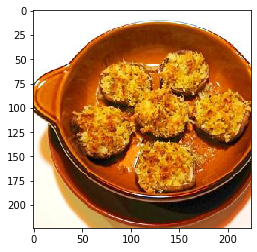

img 170: ['ニンニク', 'ゴマ油', '玉ねぎ', '卵', 'マヨネーズ', 'サラダ油', 'にんじん', '白ワイン', '刻みネギ']


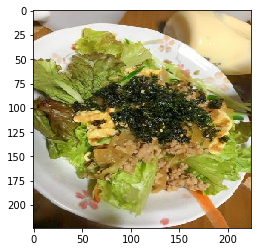

img 171: ['塩', 'ゴマ油', 'レンコン', '青海苔']


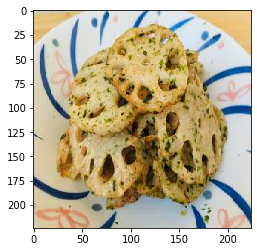

img 172: ['醤油', 'ニンニク', '塩コショウ', '片栗粉', 'キュウリ', 'こしょう', '鶏肉', '揚げ油', 'じゃがいも']


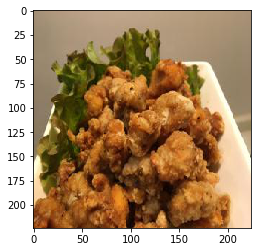

img 173: ['醤油', 'みりん', 'マヨネーズ', 'こしょう', '七味唐辛子', 'レンコン', '青海苔', '里芋']


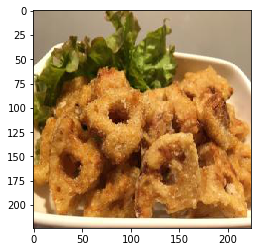

img 174: ['醤油', 'ニンニク', '生姜', 'ねぎ', '大根', 'わさび']


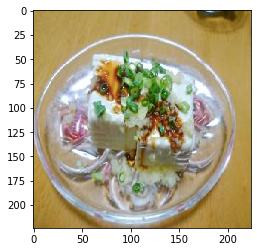

img 175: ['砂糖', 'ゴマ油', 'ゴマ', '麺つゆ', '鰹節', 'ピーマン', '鶏皮']


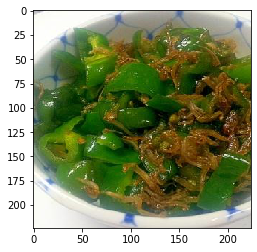

img 176: ['塩', 'ニンニク', '玉ねぎ', 'ご飯']


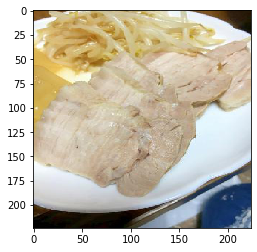

img 177: ['塩', 'ニンニク', 'ゴマ油', '塩コショウ', '玉ねぎ', 'だしの素', 'もやし']


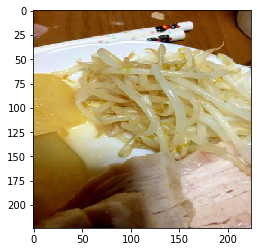

img 178: ['醤油', '砂糖', 'みりん', '卵', 'だしの素', '大根', '鱈子']


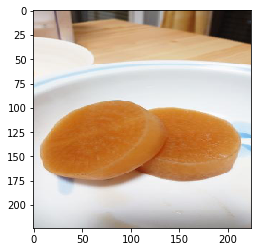

img 179: ['塩', 'オリーブオイル', 'マヨネーズ', 'チーズ', '日本酒', 'パクチー', '水菜', '鱧']


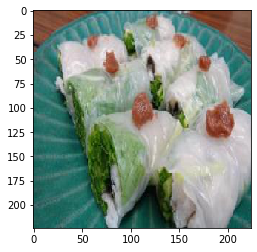

img 180: ['醤油', 'パクチー']


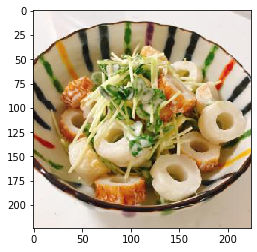

img 181: ['塩', '塩コショウ', '片栗粉', '大根', '豆腐']


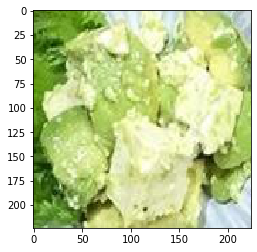

img 182: ['オリーブオイル', 'マヨネーズ', 'チーズ', 'トマト', 'クリームチーズ', '生ハム', 'カイワレ']


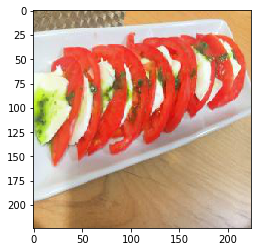

img 183: ['塩コショウ', 'チーズ', 'トマト', '大葉']


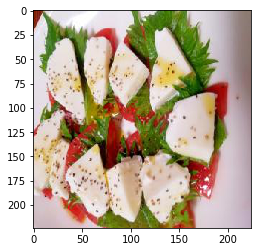

img 184: ['醤油', '塩', '生姜', '塩コショウ', 'オリーブオイル', '玉ねぎ', '刺身', '鰹', 'つぶ貝']


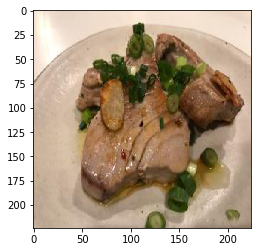

img 185: ['塩', '日本酒', 'かぶ']


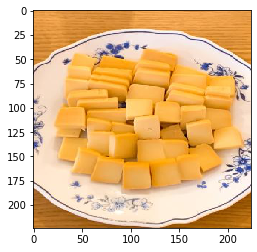

img 186: ['塩', '砂糖', 'だしの素']


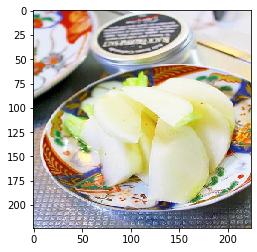

img 187: ['醤油', '塩', '砂糖', 'ニンニク', '塩コショウ', 'オリーブオイル', '黒胡椒']


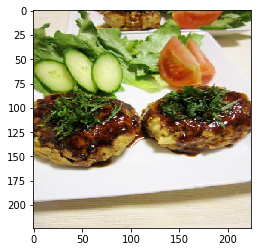

img 188: ['醤油', '塩', 'レモン', 'アボカド']


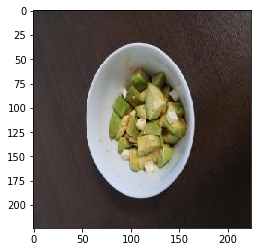

img 189: ['醤油', 'みりん', '大根', 'わさび', '鮭', '山椒']


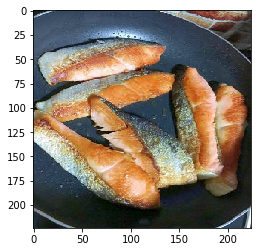

img 190: ['塩', 'オリーブオイル']


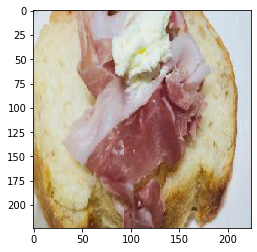

img 191: ['醤油', '塩', 'オリーブオイル', '日本酒', 'パスタ', '菜種油']


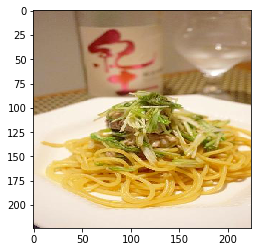

img 192: ['醤油', '塩', '黒胡椒', '日本酒', 'パスタ', '菜種油']


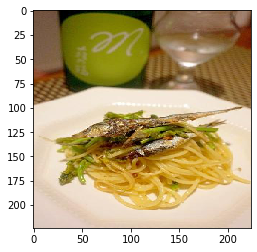

img 193: ['塩', 'オリーブオイル', '黒胡椒', 'レモン', 'こしょう', 'ポン酢', 'オリーブ油', '生ハム', '豆苗']


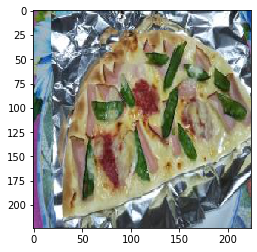

img 194: ['醤油', '砂糖', 'みりん', 'オリーブオイル', 'レモン', 'マジックソルト', '赤唐辛子']


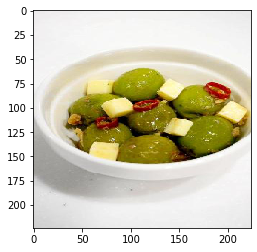

img 195: ['塩', 'ニンニク', '生姜', '卵', '白菜']


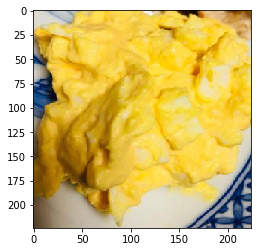

img 196: ['塩', 'オリーブオイル', '青海苔']


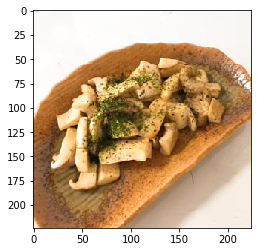

img 197: ['醤油', '塩', '砂糖', 'オリーブオイル', '玉ねぎ', 'だしの素', '酢', 'キュウリ', 'にんじん', 'トマト', '鷹の爪', 'ピーマン', 'レタス', 'パプリカ', 'ミツカン']


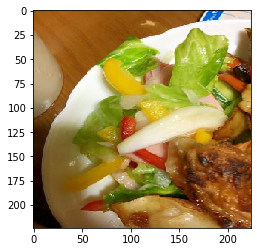

img 198: ['塩', 'マヨネーズ', '日本酒', 'レモン', 'わさび', 'アボカド', 'コーン']


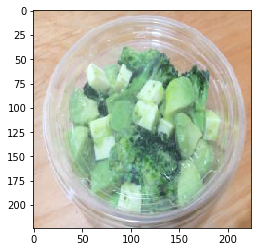

img 199: ['塩', 'みりん', 'エビ', 'ご飯', '鮭']


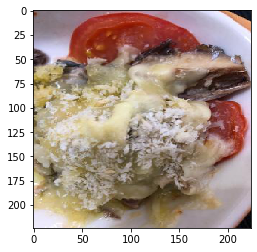

img 200: ['醤油', '青海苔']


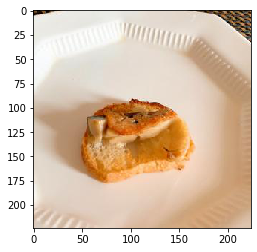

img 201: ['卵', 'チーズ', 'パン粉', 'ガーリックソルト']


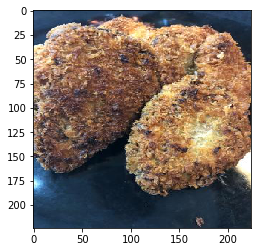

img 202: ['塩', 'オリーブオイル', '黒胡椒', 'マヨネーズ', 'チーズ', 'トマト', '白ワイン', 'ツナ']


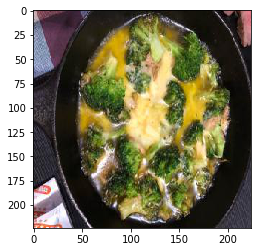

img 203: ['塩', '酒粕']


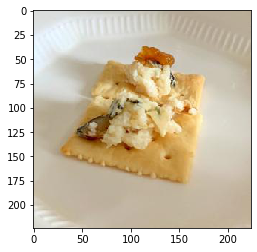

img 204: ['マヨネーズ', 'チーズ', 'トマト', 'オリーブ油', '餃子の皮', 'ハム', 'ピザ生地', '明太子']


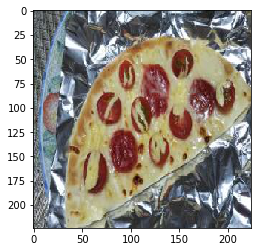

img 205: ['醤油', '塩', '生姜', '日本酒', '柚子']


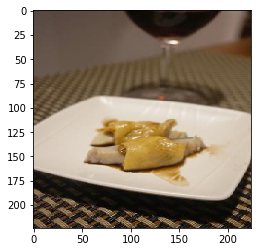

img 206: ['醤油', '塩', 'みりん', '生姜', 'マヨネーズ', '味噌', '麺つゆ', '七味唐辛子']


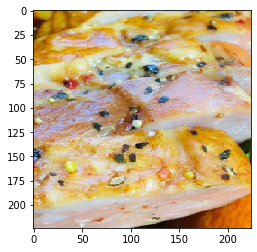

img 207: ['醤油', '塩', '黒胡椒', '卵', '日本酒']


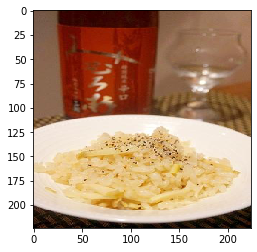

img 208: ['塩', '卵', 'レモン']


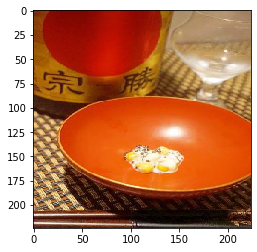

img 209: ['塩', 'レモン', '粒マスタード', '柚子', 'せり', 'チリソース']


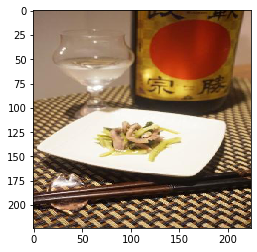

img 210: ['塩', 'ニンニク', 'オリーブオイル', 'レモン', 'ポン酢', 'オリーブ油', '砂肝', 'セロリ', 'ナンプラー']


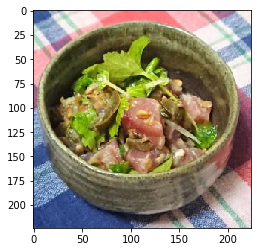

img 211: ['レモン', '白菜']


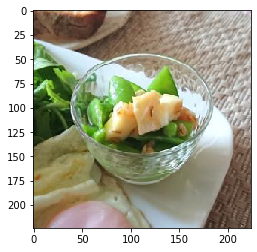

img 212: ['塩', 'レモン', '茗荷', '菜種油']


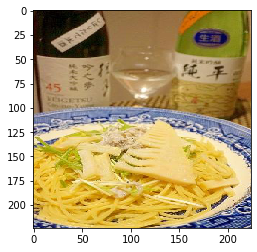

img 213: ['醤油', '塩', '菜種油', '赤唐辛子', '菜の花']


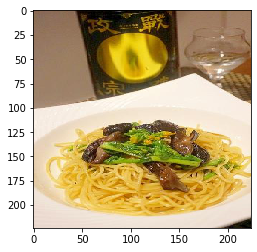

img 214: ['塩', '黒胡椒', '粒マスタード']


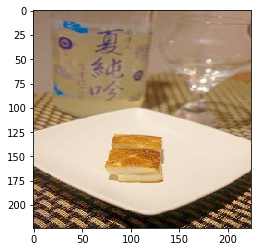

img 215: ['醤油', '塩', 'ねぎ', 'とろけるチーズ']


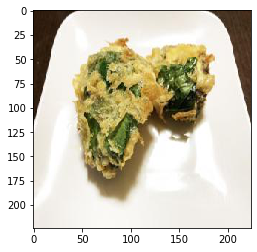

img 216: ['塩', 'ニンニク', 'オリーブオイル', 'レモン', '鴨']


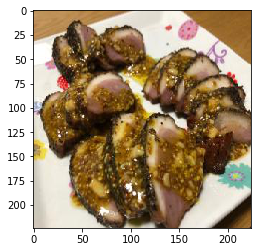

img 217: ['醤油', '塩', 'オリーブオイル', '黒胡椒', '玉ねぎ', 'バター']


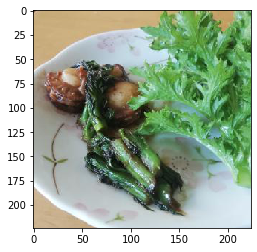

img 218: ['醤油', '塩', '砂糖', 'ゴマ油', '酢', 'ニラ']


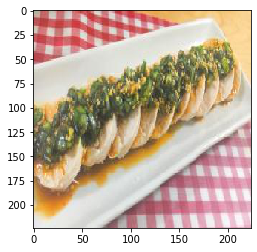

img 219: ['塩']


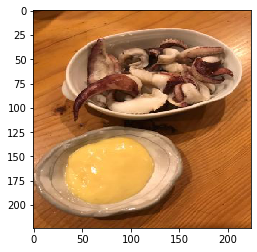

img 220: ['塩', 'オリーブオイル', 'チーズ', 'バジル', '食パン', '強力粉']


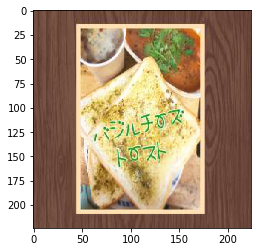

img 221: ['ゴマ油', 'マヨネーズ', 'チーズ', 'レモン']


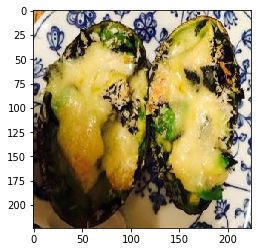

img 222: ['醤油', '塩', '砂糖', 'ニンニク', '塩コショウ', '黒胡椒', '玉ねぎ', 'レモン', 'キュウリ', 'じゃがいも', 'トマト', 'オリーブ油', 'パプリカ', 'アンチョビ']


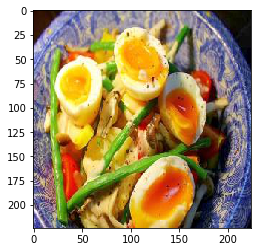

img 223: ['塩', 'オリーブオイル', 'レモン', 'こしょう', 'トマト', '白ワイン', 'アサリ']


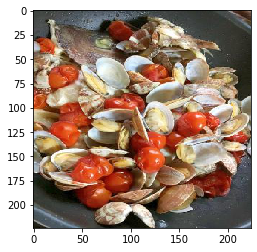

img 224: ['ゴマ油', 'レモン', 'ゴマ', 'ポン酢', 'オリーブ油', '刺身', 'タコ', 'ラー油', 'クレイジーソルト', 'カニカマ']


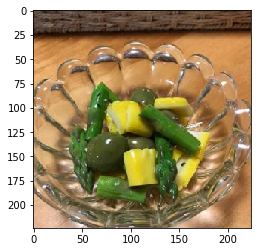

img 225: ['塩', 'だしの素', 'キュウリ', 'にんじん', 'エビ', 'キャベツ', 'ミツカン']


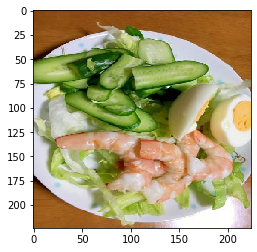

img 226: ['塩', '塩コショウ', 'オリーブオイル', '玉ねぎ', 'ステーキ']


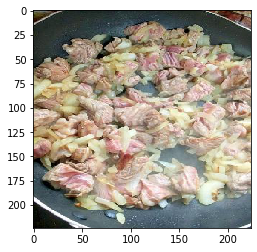

img 227: ['醤油', 'わさび', 'マグロ', '鱈子']


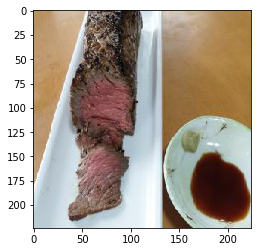

img 228: ['醤油', '塩', '生姜', 'イカ']


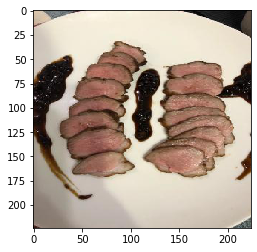

img 229: ['醤油', '生姜', '大根', 'ゴマ', 'ごぼう']


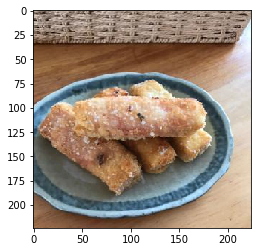

img 230: ['塩', '砂糖', 'みりん', '生姜', '黒胡椒', '砂肝', 'ウスターソース']


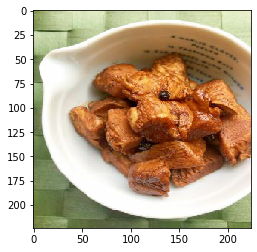

img 231: ['塩', 'ニンニク', '塩コショウ', 'オリーブオイル', '玉ねぎ', 'レモン', '白ワイン']


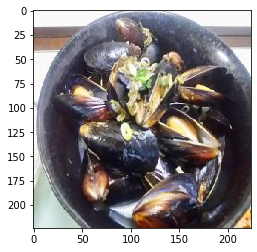

img 232: ['醤油', '塩']


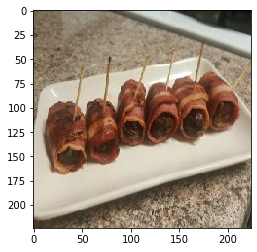

img 233: ['塩', 'オリーブオイル', 'マヨネーズ', 'レモン', '味噌', 'トマト', 'クリームチーズ', 'アボカド']


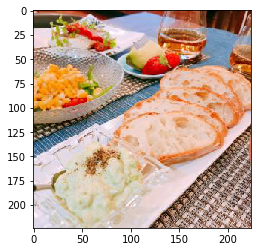

img 234: ['塩', 'ねぎ', 'オリーブオイル', 'チーズ', 'レモン', 'トマト', 'わさび']


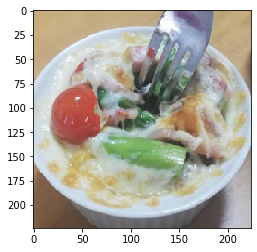

img 235: ['塩', '黒胡椒', '卵', 'マヨネーズ', 'チーズ', 'ベーコン', 'ケチャップ', '餃子の皮', 'バジル', 'ウインナー', 'クレイジーソルト']


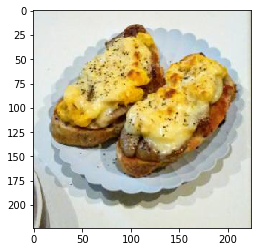

img 236: ['塩', 'オリーブオイル', 'トマト', 'オリーブ油', '刺身']


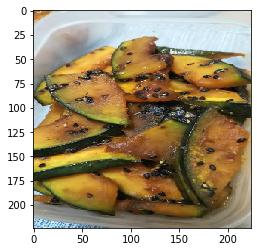

img 237: ['塩', '砂糖', '塩コショウ', 'サラダ油', '鶏肉', 'ガーリックパウダー']


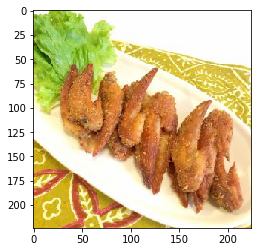

img 238: ['塩']


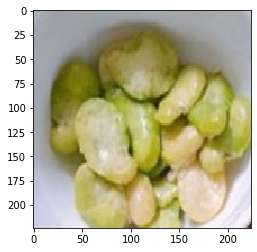

img 239: ['塩', 'オリーブオイル']


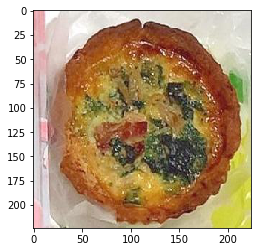

img 240: ['醤油', '砂糖', 'みりん', '生姜']


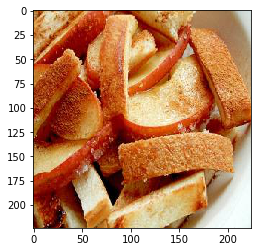

img 241: ['醤油', 'ゴマ油', '生姜', 'パクチー', 'カイワレ']


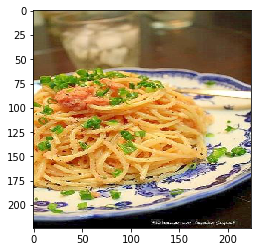

img 242: ['塩', '砂糖', 'オリーブオイル', 'チーズ', 'オリーブ油', 'ベーコン', '強力粉', 'インスタントドライイースト']


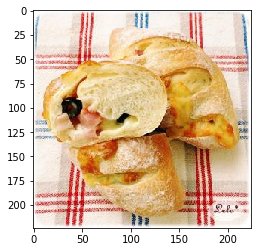

img 243: ['醤油', '塩', '海苔', '菜種油']


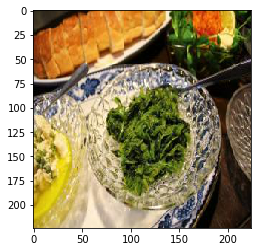

img 244: ['醤油', '卵', 'チーズ', 'ズッキーニ']


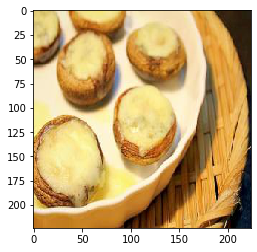

img 245: ['大根']


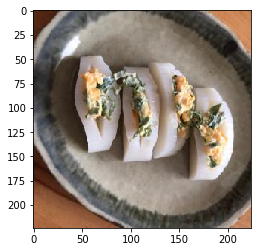

img 246: ['塩', 'だしの素']


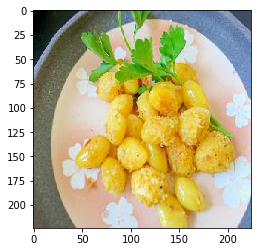

img 247: ['醤油', '塩', 'ねぎ', '刺身', '白菜', '梅干し']


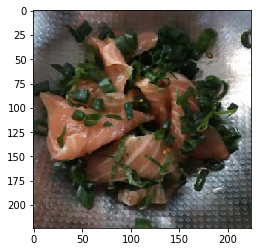

img 248: ['醤油', '刺身', 'パセリ', 'ムツ', 'せり']


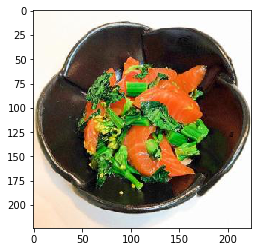

img 249: ['醤油', '塩', 'ねぎ', '大根']


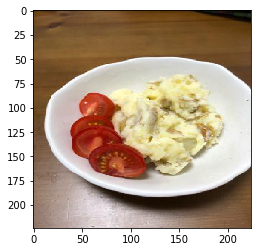

img 250: ['塩', 'にんじん', 'キャベツ']


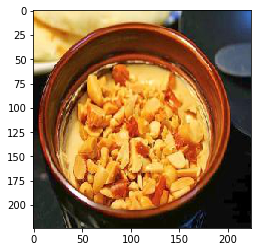

img 251: ['塩', '塩コショウ', '卵', '揚げ油', 'エリンギ']


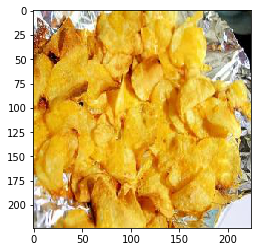

img 252: ['醤油', '塩', '生姜', 'オリーブオイル', '大葉', '刺身', 'パクチー', 'ムツ', 'せり', '鰆']


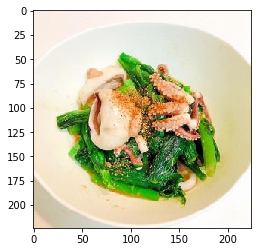

img 253: ['塩', 'マヨネーズ', 'チーズ']


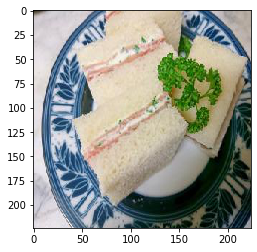

img 254: ['醤油', '塩', 'オリーブオイル', '酢']


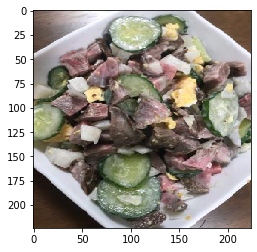

img 255: ['醤油', '塩', 'オリーブオイル', 'マヨネーズ']


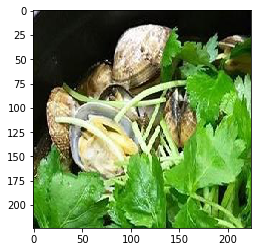

img 256: ['塩', 'ニンニク', '塩コショウ', 'マヨネーズ']


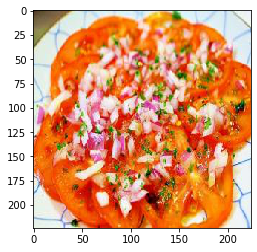

img 257: ['醤油', '鷹の爪']


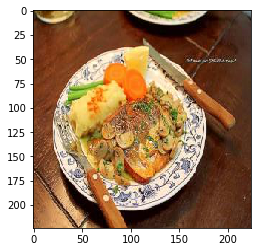

img 258: ['醤油', 'オリーブオイル', 'わさび', '刺身']


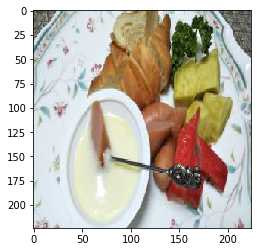

img 259: ['醤油', '塩', '砂糖', 'オリーブオイル', '酢', 'タコ']


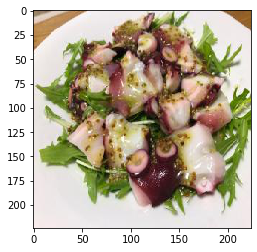

img 260: ['チーズ', '餃子の皮']


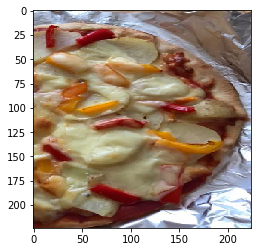

img 261: ['塩', '黒胡椒', '日本酒', '白ワイン', 'パスタ', '菜種油']


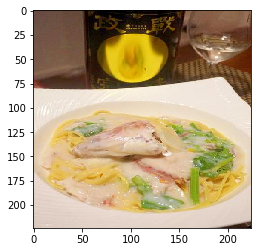

img 262: ['マヨネーズ', 'チーズ', 'こしょう', 'オリーブ油', '厚揚げ', '粒マスタード', 'ピザ生地', 'ガーリックソルト']


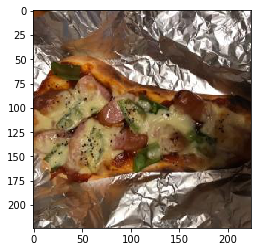

img 263: ['醤油', '塩', '塩コショウ', '刺身', 'バジル']


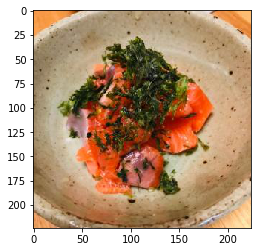

img 264: ['塩', 'ねぎ', '鷹の爪', '茗荷', 'エリンギ']


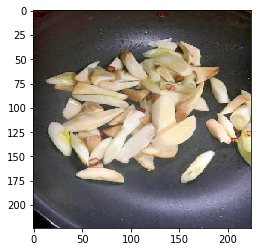

img 265: ['醤油', '塩', '粒マスタード']


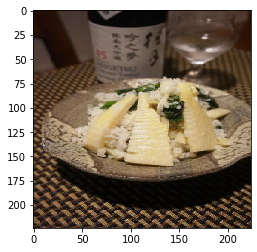

img 266: ['塩', '粒マスタード']


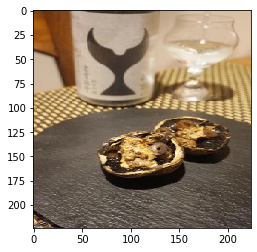

img 267: ['醤油', 'ねぎ', 'マヨネーズ', '鯵']


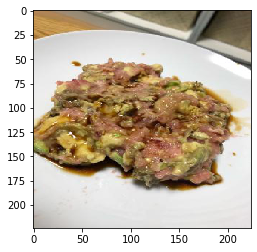

img 268: ['醤油', '梅干し', '鯵']


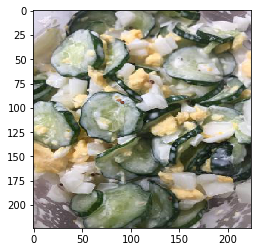

img 269: ['塩', 'レモン']


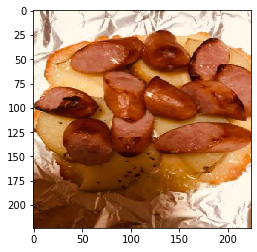

img 270: ['醤油', '塩', 'オリーブオイル']


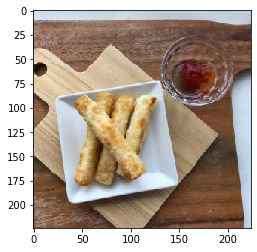

img 271: ['塩', '柿']


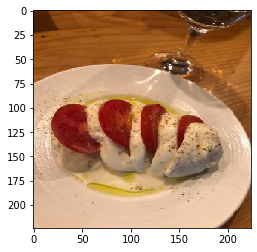

img 272: ['塩']


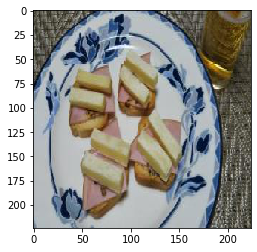

img 273: ['醤油', '塩', 'オリーブオイル', '刺身', 'パクチー', 'カイワレ']


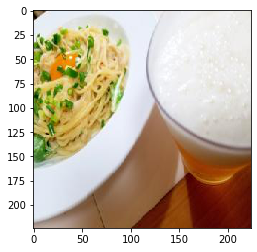

img 274: ['塩', '黒胡椒', 'マヨネーズ', 'チーズ', 'レモン', 'レタス']


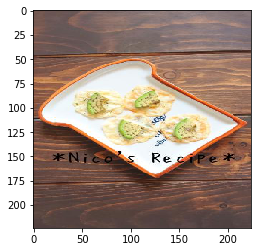

img 275: ['醤油', '塩', 'だしの素', '山椒']


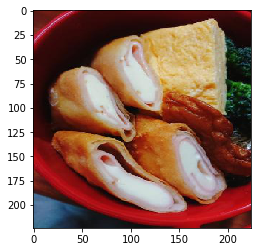

img 276: ['醤油', '砂糖', 'みりん', '生姜', 'オリーブオイル', '玉ねぎ', '刺身', '梅酢']


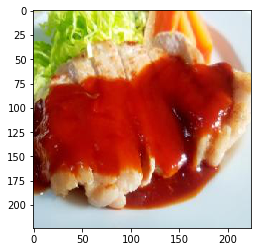

img 277: ['醤油', '砂糖', 'みりん', 'オリーブオイル', '大根', '生ハム']


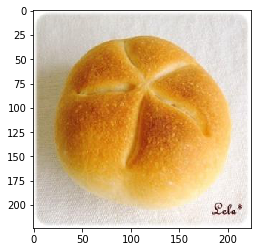

img 278: ['塩', 'ニンニク', 'オリーブオイル', '玉ねぎ']


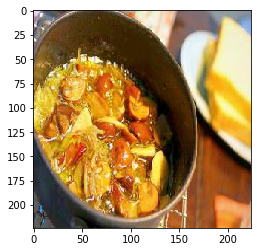

img 279: ['塩', 'チーズ', 'トマト', '餃子の皮', 'スモークサーモン']


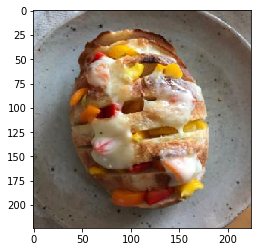

img 280: ['塩', '黒胡椒']


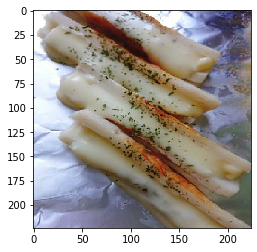

img 281: ['塩', 'ニンニク', 'オリーブオイル', 'レモン', 'トマト']


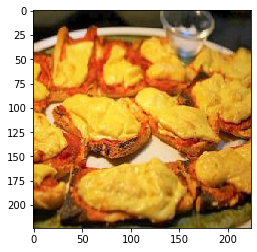

img 282: ['醤油', '塩', '砂糖', '味噌', '大根']


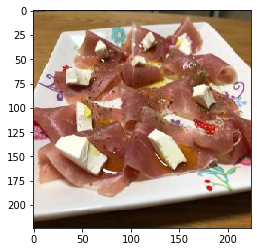

img 283: ['塩', 'ニンニク', 'オリーブオイル', '鷹の爪']


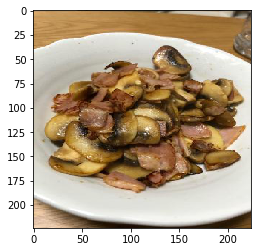

img 284: ['塩', '卵', '片栗粉', '味噌', '油揚げ', 'アボカド', 'コンソメ']


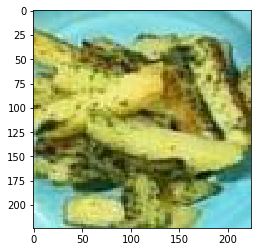

img 285: ['醤油', '塩', '卵', '日本酒', '河豚']


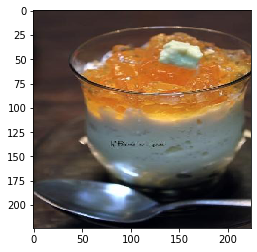

img 286: ['ニンニク', 'オリーブオイル', 'トマト', 'ベーコン']


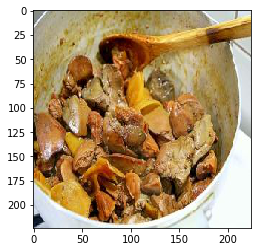

img 287: ['醤油', '塩', 'オリーブオイル', '黒胡椒', 'レモン', 'じゃがいも', 'オリーブ油', 'ガーリックパウダー']


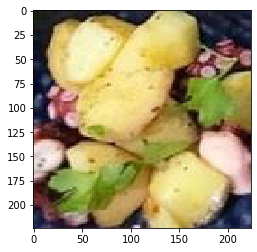

img 288: ['醤油', 'マヨネーズ', 'わさび', 'スプラウト', 'いくら']


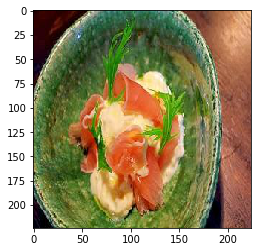

img 289: ['塩', '味噌', 'こんにゃく', '粒マスタード', 'チリソース']


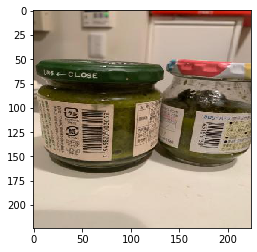

img 290: ['醤油', '塩', '黒胡椒', '日本酒']


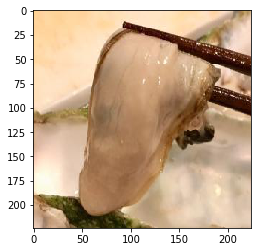

img 291: ['醤油', '塩', '味噌', '柚子', 'せり']


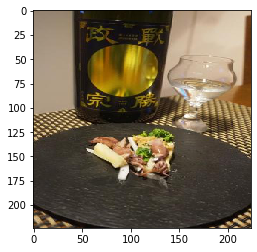

img 292: ['醤油', '砂糖', '大根', '鶏肉', '焼肉のたれ']


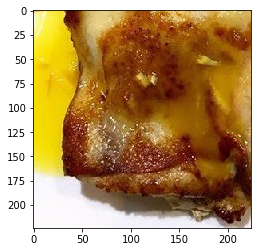

img 293: ['醤油', '砂糖', 'みりん', '生姜', 'ねぎ', 'だしの素', '大根', 'はちみつ', '一味唐辛子', '牛肉']


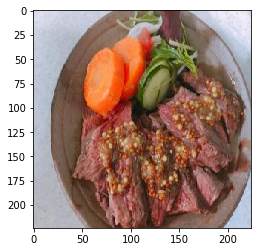

img 294: ['塩', '砂糖', '酢', 'ホタテ']


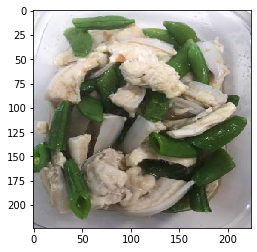

img 295: ['塩', '生姜', 'ねぎ', 'わさび']


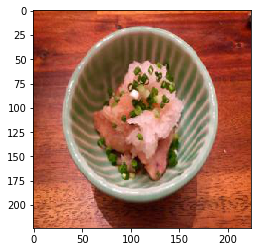

img 296: ['塩', '豆腐', 'レタス']


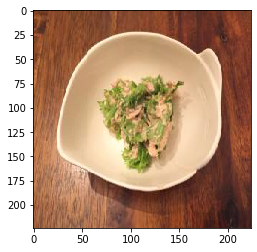

img 297: ['醤油', '塩', 'こしょう', '豆腐', '牡蠣']


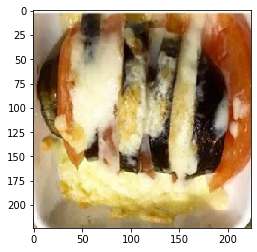

img 298: ['醤油', '塩', '生姜', 'ねぎ', '鶏肉', 'わさび']


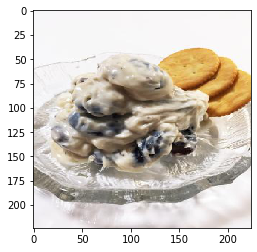

img 299: ['塩']


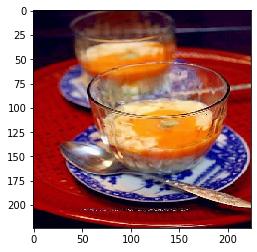

img 300: ['醤油', '塩', '日本酒', '味噌', 'キャベツ', '柚子', '柿']


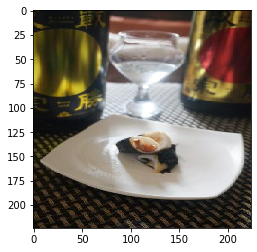

img 301: ['塩', 'キャベツ', '柚子']


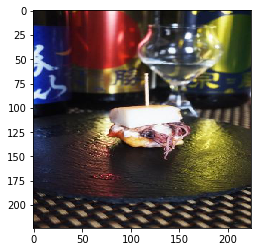

In [16]:
# test
preds = model.predict(x_test)
for i, (x, pred) in enumerate(zip(x_test, preds)):
    indexes = np.where(pred > 0.2)[0]
    words = [detokenizer[idx+1] for idx in indexes]
    print(f'img {i}: {words}')
    plt.imshow(x/255.0)
    plt.show()
    print(f'=========================================')
    if i > 300:
        break

In [0]:
# vocab_size = len(tokenizer.word_index) + 1
# caption_len = len(y_train[0])

# K.clear_session()

# # VGG
# encoder_input = Input(shape=(224, 224, 3))
# encoder_input_normalized = Lambda(lambda x: x / 255.)(encoder_input) # [0, 255) -> [0, 1)
# encoder = VGG16(weights='imagenet', include_top=False, input_tensor=encoder_input_normalized)

# # パラメータを固定
# for layer in encoder.layers:
#     layer.trainable = False

# # CNNの出力
# u = Flatten()(encoder.output)

# vgg_model = Model(encoder_input, u)

# # VGGから特徴量を抽出
# x_train_features = []
# x_test_features = []

# for x in tqdm(x_train):
#     x_features = vgg_model.predict(x[np.newaxis]).flatten()
#     x_train_features.append(x_features)

# for x in tqdm(x_test):
#     x_features = vgg_model.predict(x[np.newaxis]).flatten()
#     x_test_features.append(x_features)

# x_train_features = np.stack(x_train_features, axis=0)
# x_test_features = np.stack(x_test_features, axis=0)

# # 特徴量を保存
# np.save('/root/userspace/private/lesson5/data/x_train_features', x_train_features)
# np.save('/root/userspace/private/lesson5/data/x_test_features', x_test_features)